In [765]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
from __future__ import print_function
import numpy as np
from tqdm import tqdm
import matplotlib.colors as colors
import matplotlib.pyplot as plt
from matplotlib.dates import DateFormatter
from matplotlib import cm
plt.rcParams.update({'font.size': 14, 'lines.markersize' : 4})

from scipy.optimize import curve_fit
import sys, os
import time, datetime
from datetime import timedelta
import pandas as pd
sys.path.append('/reg/d/psdm/tmo/tmox51020/results/paris/recon')
from recon_funcs import *
import h5py

/reg/neh/home/tdd14/modules/CPBASEX/pbasex-Python/pbasex/gData.py:55: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  if gData['rBF'] is not 'custom':


Hi! I imported. 


In [3]:
from matplotlib import cm
from matplotlib.colors import ListedColormap
my_cmap = cm.get_cmap('jet')
xr = np.linspace(0, 1, 2000)
my_cmap = my_cmap(xr)
my_cmap[0][-1] = 0
my_cmap = ListedColormap(my_cmap)


X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskhole=np.zeros((1024,1024))
maskhole[(rs>200) & (rs<332)]=1
maskhole[(Y<512+140)]=0
maskhole[:512,:] = 0

In [647]:
def make_MM(x0):
    xshift, yshift =  x0[8], x0[9] 

    # Coordinates that you want to Perspective Transform
    pts1 = np.float32([[0,0],\
                       [0,1024],\
                       [1024,0],\
                       [1024, 1024]])


    # Size of the Transformed Image
    pts2 = np.float32([[0+xshift-x0[0],0 + yshift-x0[1]],\
                       [0+xshift-x0[2],1024 + yshift-x0[3]],\
                       [1024+xshift-x0[4],0 + yshift-x0[5]],\
                       [1024+xshift-x0[6],1024 + yshift-x0[7]]])

    MM = cv2.getPerspectiveTransform(pts1,pts2)
    return MM

X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskhm=np.zeros((1024,1024))
maskhm[(rs>120) & (rs<420)]=1
nmask = np.reshape(rebin(rebin(maskhm,4),4),[64**2,])


x,y, = 530,512
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-x)**2+(Y-y)**2)
mask=np.zeros((1024,1024))
mask[rs>1*48]=1

nmask = np.reshape(rebin(rebin(maskhm,4),4),[64**2,]) #rebin later
nnmask = (rebin(np.reshape(nmask, [64,64]))).flatten()
nnmask = rebin(rebin(maskhm,4),4)
#nnmask = (rebin(np.reshape(nmask, [64,64])*(inbg))).flatten()
nnmask[nnmask<0.5] = 0
nnmask[nnmask>=0.5] = 1

maskscale = np.zeros((1024,1024))
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskscale [(rs>120) & (rs<270)]=1

def make_quads(x0):
    quads=np.ones((1024,1024))
    quads[:512,:512]= x0[0]
    quads[:512,512:]= x0[1]
    quads[512:,:512]= x0[2]
    quads[512:,512:]= x0[3]
    return quads


In [5]:
PR = PolarRebin('/reg/d/psdm/tmo/tmox51020/results/paris/recon/PR_c32_r32_th32.h5') 

gasoff = np.load('/reg/d/psdm/tmo/tmox51020/results/paris/recon/gas_off_X510_112.npy')
inner_bg = np.load('/reg/d/psdm/tmo/tmox51020/results/paris/recon/inner_bg2.npy')
gasoff = np.load('/reg/d/psdm/tmo/tmox51020/results/paris/recon/gas_off_X510_112.npy')
inner_bg = np.load('/reg/d/psdm/tmo/tmox51020/results/paris/recon/inner_bg2.npy')

resid = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Jan/resid_bg_run110_2.npy') #np.load('/cds/home/p/paris/reconVMI_clean/resid_bg_mfgf10_unsat5.npy')
residold = np.load('/cds/home/p/paris/reconVMI_clean/resid_bg_mfgf10.npy')
#for background cal
ims_bg = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Aug/bg_for_cal.npy')
thresh = 32
gfsig = 0.985 #0.985 #0.875
 #int(sys.argv[7])
gfcart = 0.25 #applied to the simulated image to try to make it match the measured
mfcart = 1

In [ ]:
runnum = 112
thresh = 32
MM = make_MM([-17.998,-2.74, 17.9, -17.39, 17.86, 8.52, -3.85, 17.9, 11.47, 47.86])
resid = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Jan/bg_run_112_Mar.npy')
quads = cv2.warpPerspective(make_quads([0.97,0.967,0.99,0.999]),MM,(1024,1024))

maskscale = np.zeros((1024,1024))
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskscale[(rs>130) & (rs<220)]=1
maskscale[(Y>26*16) & (Y<38*16)]=0

maskscale = np.zeros((1024,1024))
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskscale [(rs>120) & (rs<270)]=1

fanmask = np.ones((1024,1024))
# X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
# rs=np.sqrt((X-512)**2+(Y-512)**2)
# fanmask [(16*46.5<X) &(X<16*58) & (32*16<Y) & (Y<42*16)]=0

mfn = 25 
gfn = 15 
tt = np.array([4410466482935666616, 4410466483277240371, 4410466483602167976,
       4410466487221983517, 4410466487288568117, 4410466487363541328,
       4410466487455291761, 4410466487555168661, 4410466487563557272,
       4410466487796865516, 4410466488038431299, 4410466496044571713,
       4410466496277748885, 4410466496344464557, 4410466500189199731,
       4410466500547419636, 4410466509161603277, 4410466509494919493,
       4410466521962095847, 4410466522078749969, 4410466525815219632,
       4410466526464943770, 4410466526673217253, 4410466534479341723,
       4410466534670969056, 4410466547862973831, 4410466551532727822,
       4410466551741001305, 4410466551857655427, 4410466552082575060,
       4410466573846689349, 4410466594452913173, 4410466594694478956,
       4410466594902752439, 4410466598747487613, 4410466599730396895,
       4410466603933220902, 4410466607877964048, 4410466612513981171,
       4410466616008885051, 4410466616092115801, 4410466616225416073,
       4410466616733582400, 4410466616900174972, 4410466620736521535,
       4410466620753167685, 4410466625222723308, 4410466625389315880,
       4410466628825892699, 4410466629317412876, 4410466633770191277,
       4410466634070084121, 4410466637939722984, 4410466638006438656,
       4410466641834527680, 4410466651198312359, 4410466654584819656,
       4410466668401644880, 4410466671771506027, 4410466671804929399,
       4410466671896548760, 4410466672254768665, 4410466680352528440,
       4410466680819013856, 4410466684855376363, 4410466684972030485,
       4410466685513489112, 4410466689674894352, 4410466693294840965,
       4410466706362196223, 4410466715076649980, 4410466715318215763,
       4410466715459904646, 4410466715501454485, 4410466719921071658,
       4410466727627319228, 4410466728127096944, 4410466732255078812,
       4410466732713306689, 4410466741127474386, 4410466744847297899,
       4410466745005501860, 4410466745388756526, 4410466745605287548,
       4410466749133483728, 4410466749616615294, 4410466750007996427,
       4410466753386377257, 4410466753502900307, 4410466753519546457,
       4410466753627943040, 4410466758313898613, 4410466761967006454,
       4410466762749899792, 4410466766536307905, 4410466766694642938,
       4410466771014121067, 4410466784180828937, 4410466800900636708,
       4410466814050829500, 4410466860782982013, 4410466860891247524,
       4410466860991124424, 4410466861457740912, 4410466865519007108,
       4410466869746996948, 4410466870080182092, 4410466925753018715,
       4410466930289290010, 4410466981025037018, 4410467011094660277,
       4410467020358436984, 4410467041731039068, 4410467042022543301,
       4410467066956109577, 4410467093272092735, 4410467093405393007,
       4410467105780687856, 4410467106022122567, 4410467110141715824,
       4410467118580787210, 4410467118880680054, 4410467123391785516,
       4410467136200535625, 4410467144531472572, 4410467148692746740,
       4410467149450867461, 4410467157315318992, 4410467175126563668,
       4410467183348972960, 4410467187576962800, 4410467191937990768,
       4410467192021352590, 4410467200601981787, 4410467209016018412,
       4410467209574123189, 4410467213010700008, 4410467217463347337,
       4410467226635242539, 4410467239018794927, 4410467256255026532,
       4410467264735909901, 4410467273316539098, 4410467281855618456,
       4410467286316654396, 4410467286524796807, 4410467286616416168,
       4410467295147106915, 4410467311800461126, 4410467312416892964,
       4410467324617468774, 4410467337859543071, 4410467342037463389,
       4410467342112436600, 4410467354904540559, 4410467363985340688,
       4410467397842682780, 4410467428163571153, 4410467428171828692,
       4410467428513402447, 4410467436452958261, 4410467436502896711,
       4410467453881734703, 4410467453940061764, 4410467458601244720,
       4410467462862657932, 4410467488239378799, 4410467501615146584,
       4410467505126827686, 4410467509338302448, 4410467513666300260,
       4410467513749662082, 4410467513757919621, 4410467513891219893,
       4410467514007874015, 4410467518544276382, 4410467522414046317,
       4410467530828476158, 4410467539609514515, 4410467543854150505,
       4410467561507322292, 4410467587466396265, 4410467591877624827,
       4410467604569851886, 4410467613009185416, 4410467625459846692,
       4410467625509785142, 4410467630129418259, 4410467638543717028,
       4410467660217129460, 4410467664245103356, 4410467668872994012,
       4410467672859418069, 4410467677603962847, 4410467689813058340,
       4410467694240933052, 4410467694582375735, 4410467698993604297,
       4410467702663358288, 4410467702696781660, 4410467737419461408,
       4410467742038832381, 4410467754356193385, 4410467758759033336], dtype =np.uint64)

print(len(tt))
print(len(np.unique(tt)))

204
204


In [510]:
b = np.array([4410466483435575404, 4410466500189199731, 4410466513089700273,
       4410466526673217253, 4410466573846689349, 4410466594902752439,
       4410466599455538812, 4410466616733582400, 4410466625389315880,
       4410466638006438656, 4410466651198312359, 4410466654584819656,
       4410466668401644880, 4410466684855376363, 4410466715076649980,
       4410466715459904646, 4410466745388756526, 4410466749616615294,
       4410466750007996427, 4410466753627943040, 4410466762749899792,
       4410466860991124424, 4410466861457740912, 4410466865519007108,
       4410467363985340688])

In [511]:
for i in range(len(tt)):
    if tt[i] in b: print(i)
    

14
22
30
33
42
47
53
55
56
57
64
70
72
82
85
86
90
93
102
103
104
155


In [226]:
tt = tt[[33, 102, 114, 121, 127, 129, 139, 155, 169, 171, 175, 177, 184, 191, 194, 195, 202]]

In [ ]:
cVMIs = []
rawish= []
detsum = []
maxim = []
cVMIsold = []
specs = []
unproc = []
gds = []
tmstmps = []

ds=ps.DataSource(exp = 'tmox51020', run= runnum, timestamps=tt)
#ds=ps.DataSource(exp = 'tmox51020', run= runnum, filter = lambda evt:evt.timestamp in tt)

run = next(ds.runs())

opal1 = run.Detector('tmo_opal1') # OPAL camera looking at the holey mirror
gmd = run.Detector("gmd") # gas intensity detector 
timing = run.Detector('timing') # this gives access to evr codes
ebeam = run.Detector("ebeam")
opalfzp = run.Detector('tmo_fzpopal') 



if hasattr(run, 'epicsinfo'):
    epics_strs = [item[0] for item in run.epicsinfo.keys()][1:] # first one is weird
    epics_detectors = [run.Detector(item) for item in epics_strs]    

for nevent, event in enumerate(run.events()):

    # data = {'epics_'+epic_str: epic_det(event) for epic_str, epic_det in zip(epics_strs, epics_detectors)}        
    # if any(type(val) not in [int, float] for val in data.values()):
    #     print("Bad EPICS: %d" % nevent)
    #     #Nbad += 1
    #     continue

    # fetch the information from the different events
    im_look=np.copy(opal1.raw.raw(event))  #opal1im_i=np.copy(opal1.raw.image(event)) #doesn't work since update
    im1=im_look

    ims = np.rot90(im1*mask)
    rawish.append(ims)
    detsum.append(np.sum(ims))
    #ims = cv2.warpPerspective(ims,MM,(1024,1024))
    gasoff = 0 #gasoff0#/np.mean(gasoff0)*np.mean(ims)
    ims = cv2.warpPerspective(ims-gasoff,MM,(1024,1024))
    unproc.append(ims)
    ims = ims*quads
    ims[ims<0] = 0
    ims2 = np.copy(ims)
    ims2 = mf(ims2, mfn)
    ims2 = gf(ims2, gfn)
    ims2= rebin(rebin(ims2,4),4)
    

    #resid_scale = resid/np.mean(resid[24:36,22:27])*np.mean(ims2[24:36,22:27])
    resid_scale = resid/np.mean(resid*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))
    #resid_test = resid/np.mean(resid*rebin(rebin(testmask,4),4))*np.mean(ims2*rebin(rebin(testmask,4),4))
    #residold_scale = residold/np.mean(residold*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))
    #ims2old = ims2 - residold_scale
    #testim = ims2 - resid_test
    maxim.append(np.max(ims2))
    ims2 = ims2 - resid_scale
    ims2 = gf(ims2,.25)
    #testim = gf(testim,.25)
    #ims2old = gf(ims2old,.25)
    #ims2 = rebin(ims2) #*inbg
    ims2 = ims2*rebin(rebin(maskhm*fanmask,4),4)*250/np.max(ims2)
    #testim = testim *rebin(rebin(maskhm,4),4)*250/np.max(testim)
    #ims2old = ims2old*rebin(rebin(maskhm,4),4)*250/np.max(ims2old)
    ims2[ims2<thresh] = 0
    #testim[testim<thresh] = 0
    #ims2old[ims2old<thresh] = 0
    cVMIs.append(ims2)
    #cVMIsold.append(ims2old)
    '''
    fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (8,4))
    axs[0].pcolormesh(ims2, cmap = my_cmap)
    axs[0].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    axs[1].pcolormesh(testim, cmap = my_cmap)
    axs[1].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.show()
    '''
    
    opalfz= np.copy(opalfzp.raw.image(event)) #np.copy(opal1.raw.image(event)) #np.copy(opal1.raw.raw(event))
    zps_data = opalfz
    zps_pixel = 100+np.argmax(np.sum(zps_data[100:900],axis=1))
    px_2d_width = 25 #spacing to cut the 2d image slice to store. Typically 50 pixel width. 25 on either side
    px_edge_width = 5 #spacing to integrate for the line out. 

    zps_2d = zps_data[zps_pixel-px_2d_width:zps_pixel+px_2d_width][:]
    zps = zps_data[zps_pixel-px_edge_width:zps_pixel+px_edge_width][:].mean(0)#
    zps_bg = zps_data[zps_pixel-px_2d_width:zps_pixel-px_2d_width+px_edge_width][:].mean(0)#
    zps = zps-zps_bg
    spec = np.squeeze(fastsmooth1(zps,10))
    spec = np.array(np.squeeze(spec) - np.mean(np.squeeze(spec)[800:900])) 
    specs.append(spec)
    gd_i=gmd.raw.energy(event)
    gds.append(gd_i)
    tmstmps.append(event.timestamp)
    print(event.timestamp) 
    

4410466482935666616
4410466483277240371
4410466483602167976
4410466487221983517
4410466487288568117
4410466487363541328
4410466487455291761
4410466487555168661
4410466487563557272
4410466487796865516
4410466488038431299
4410466496044571713
4410466496277748885
4410466496344464557
4410466500189199731
4410466500547419636
4410466509161603277
4410466509494919493
4410466521962095847
4410466522078749969
4410466525815219632
4410466526464943770
4410466526673217253
4410466534479341723
4410466534670969056
4410466547862973831
4410466551532727822
4410466551741001305
4410466551857655427
4410466552082575060
4410466573846689349
4410466594452913173
4410466594694478956
4410466594902752439
4410466598747487613
4410466599730396895
4410466603933220902
4410466607877964048
4410466612513981171
4410466616008885051
4410466616092115801
4410466616225416073
4410466616733582400
4410466616900174972
4410466620736521535
4410466620753167685
4410466625222723308
4410466625389315880
4410466628825892699
4410466629317412876


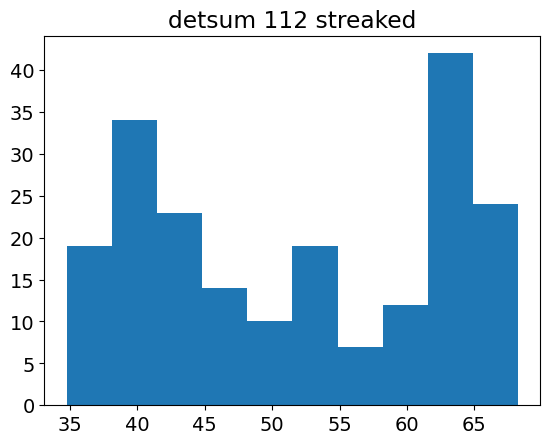

Text(0.5, 1.0, 'maxim 112 streaked')

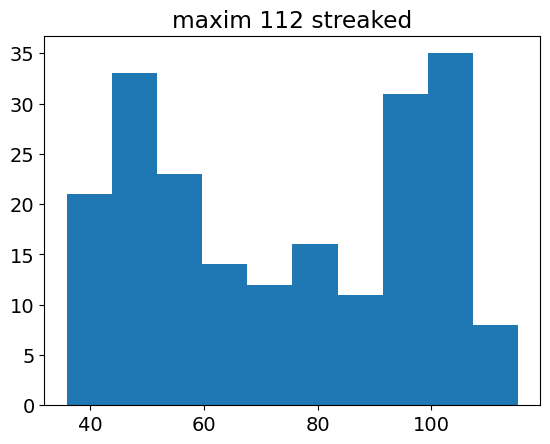

In [60]:
plt.hist(np.array(detsum)/1e6)
plt.title('detsum 112 streaked')
plt.show()
plt.hist(maxim)
plt.title('maxim 112 streaked')

In [61]:
# resid2 = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Jan/bg_run_112_Jul27.npy')
# quads2 = cv2.warpPerspective(make_quads([0.92, 0.92837547, 0.93816438, 0.96240218]),MM,(1024,1024))



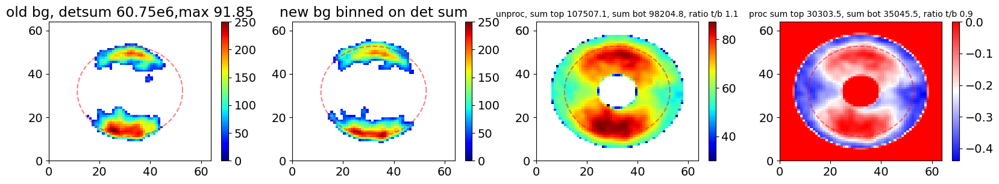

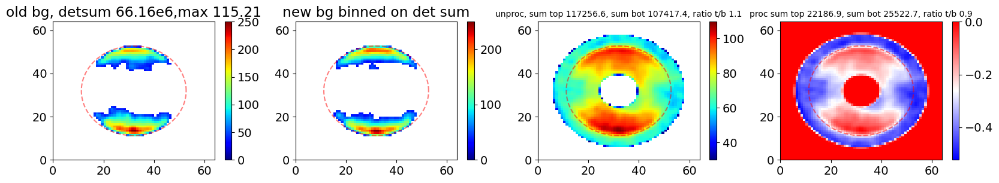

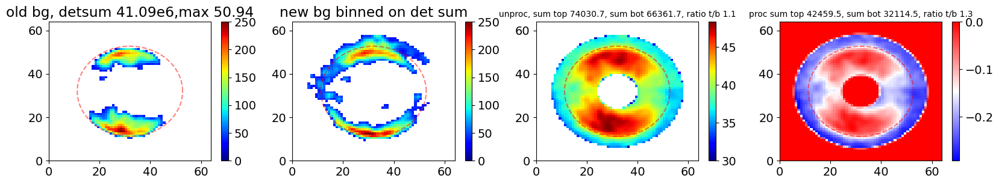

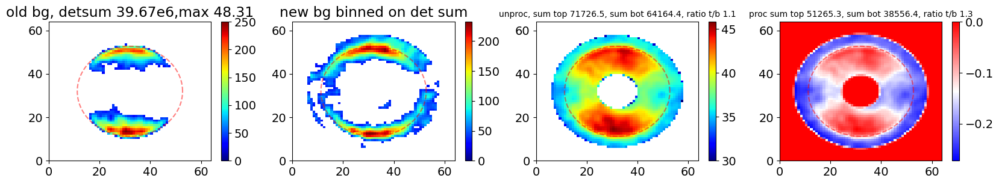

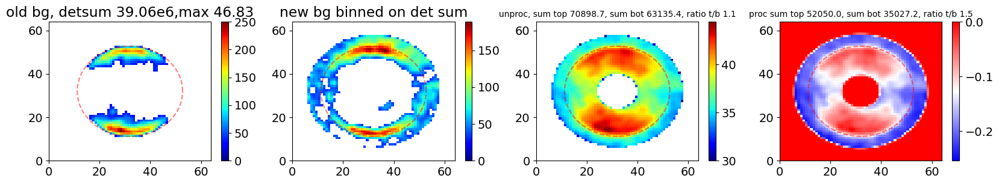

...

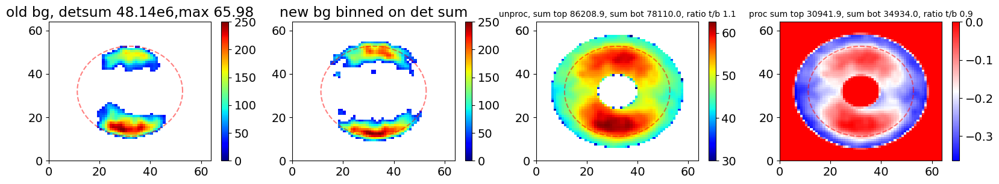

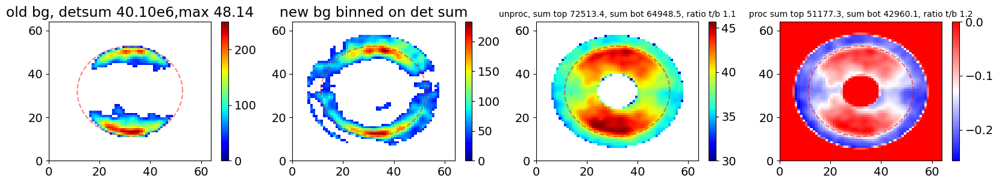

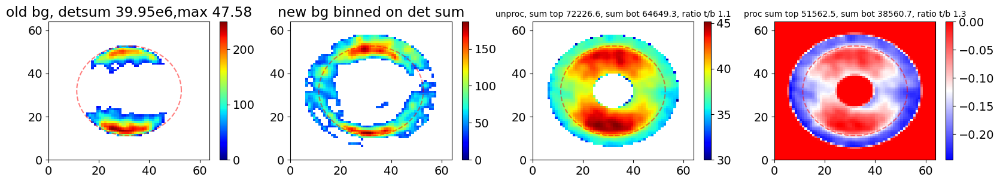

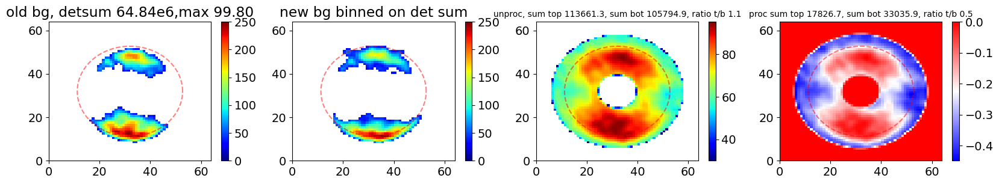

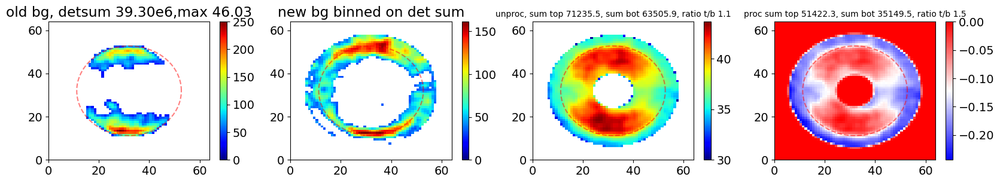

In [65]:
phi_rad = np.linspace(0,360,100)*np.pi/180

for i in range(len(specs)):
    fig,axs = plt.subplots(nrows = 1, ncols = 4, figsize = (20,3))
    c = cVMIs[i]
    c[c<0] = 0
    cVMIs[i] = c
    p =axs[0].pcolormesh(c, cmap = my_cmap)
    axs[0].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.colorbar(p,ax = axs[0])
    #axs[0].set_title('detsum %1.2fe6, max %1.2f' %(detsum[i]/1e6,maxim[i]))
    axs[0].set_title('old bg, detsum %1.2fe6,max %1.2f' %(detsum[i]/1e6,maxim[i]))
    
    ims = unproc[i]*quads2
    ims[ims<0] = 0
    ims2 = np.copy(ims)
    ims2 = mf(ims2, mfn)
    ims2 = gf(ims2, gfn)
    ims2= rebin(rebin(ims2,4),4)
    resid_scale = resid2/np.mean(resid2*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))
    p = axs[2].pcolormesh(rebin(rebin(maskhm,4),4)*ims2, cmap = my_cmap, vmin  = 30)
    axs[2].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.colorbar(p,ax = axs[2])
    bottom = ims2[:32,:]
    top = ims2[32:,:]
    axs[2].set_title('unproc, sum top %1.1f, sum bot %1.1f, ratio t/b %1.1f' %(np.sum(top),np.sum(bottom),np.sum(top)/np.sum(bottom)), fontsize = 10)
    
    p3 = axs[3].pcolormesh(rebin(rebin(maskhm,4),4)*(ims2/np.max(ims2) - avg_unstreak/np.max(avg_unstreak)), cmap = 'bwr')
    
    ims2 = ims2 - resid_scale
    ims2 = gf(ims2,.25)
    ims2 = ims2*rebin(rebin(maskhm*fanmask,4),4)*250/np.max(ims2)

    ims2[ims2<thresh] = 0
    p =axs[1].pcolormesh(ims2, cmap = my_cmap)
    axs[1].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.colorbar(p,ax = axs[1])
    axs[1].set_title('new bg binned on det sum')
    bottom = ims2[:32,:]
    top = ims2[32:,:]
    axs[3].set_title('proc sum top %1.1f, sum bot %1.1f, ratio t/b %1.1f' %(np.sum(top),np.sum(bottom),np.sum(top)/np.sum(bottom)), fontsize = 10)
    axs[3].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    plt.colorbar(p3,ax = axs[3])
    
    plt.show()

In [949]:
#Check unstreaked
exp =  "tmox51020" #"tmoly9120" #'tmox45719'
gas_jet = 1
print_at = 20
runnum = 112 #112 #106 #93 #76 #73
gmd_min = 0.05 #0.12 #0.15
gmd_max = 25
#bgdat = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Jan/bgdat_run_112_Jul27_2.npy')
bgdat = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Jan/bgdat_run_112_Jul28.npy')
bins = bgdat['bins']          

In [950]:
nn = 0
ds = ps.DataSource(exp=exp, run=runnum)
run = next(ds.runs())

if hasattr(run, 'epicsinfo'):
    epics_strs = [item[0] for item in run.epicsinfo.keys()][1:] # first one is weird
    epics_detectors = [run.Detector(item) for item in epics_strs]    


# specify detectors here
opal1 = run.Detector('tmo_opal1') # OPAL camera looking at the holey mirror
gmd = run.Detector("gmd") # gas intensity detector 
xgmd = run.Detector("xgmd") # gas intensity detector 
timing = run.Detector('timing') # this gives access to evr codes
ebeam = run.Detector("ebeam")
opalfzp = run.Detector('tmo_fzpopal') 



ims_bg = [] # initialize the list of example images here
GDs_bg = []
xGDs_bg = []
detsum = []
specs = []
jet_timing_bg = []
timestamps = []
cen = []
printed = -2

for nevent, event in enumerate(run.events()): # loop over events (shots) in the run

    # fetch the information from the different events
    opal1im_i=np.copy(opal1.raw.raw(event))
    #opal1im_i=np.copy(opal1.raw.image(event)) #doesn't work since update
    gd_i=gmd.raw.energy(event)
    xgd_i=xgmd.raw.energy(event)
    evr=timing.raw.eventcodes(event)
    L3 = ebeam.raw.ebeamL3Energy(event)

    # identify relevant event codes
    gas=evr[70] # did the gas jet fire
    ir_timed=evr[67] # was the ir laser timed
    ir_misttimed=evr[68] # was the ir laser mis-timed

    
    #if opal1im_i is None or gd_i is None or gd_i<gmd_min or (gas != gas_jet): continue
    if opal1im_i is None or gd_i is None or gd_i>gmd_max or gd_i<gmd_min or (gas != gas_jet): continue
    if np.sum(opal1im_i*mask) < 36e6: continue  
    #if np.sum(opal1im_i*mask) < 37e6: continue   
# #     if np.sum(opal1im_i*mask) > 40e6: continue
# #     if np.sum(opal1im_i*mask) < 42e6: continue
# #     if event.timestamp < 4410498451167543084: continue
# #     if np.sum(opal1im_i) < 46e6: continue
    
    data = {'epics_'+epic_str: epic_det(event) for epic_str, epic_det in zip(epics_strs, epics_detectors)}        
    if any(type(val) not in [int, float] for val in data.values()):
        print("Bad EPICS: %d" % nevent)
        #Nbad += 1
        continue
        
        
    if ir_misttimed:
        ims = np.rot90(opal1im_i*mask)
        #ims = ims/np.sum(ims)
        #ims = cv2.warpPerspective(ims,MM,(1024,1024))
        #ims_bg.append(ims[100:900,100:900])
        
        opalfz= np.copy(opalfzp.raw.image(event)) #np.copy(opal1.raw.image(event)) #np.copy(opal1.raw.raw(event))
        zps_data = opalfz
        zps_pixel = 100+np.argmax(np.sum(zps_data[100:900],axis=1))
        px_2d_width = 25 #spacing to cut the 2d image slice to store. Typically 50 pixel width. 25 on either side
        px_edge_width = 5 #spacing to integrate for the line out. 

        zps_2d = zps_data[zps_pixel-px_2d_width:zps_pixel+px_2d_width][:]
        zps = zps_data[zps_pixel-px_edge_width:zps_pixel+px_edge_width][:].mean(0)#
        zps_bg = zps_data[zps_pixel-px_2d_width:zps_pixel-px_2d_width+px_edge_width][:].mean(0)#
        zps = zps-zps_bg
        spec = np.squeeze(fastsmooth1(zps,10))
        spec = np.array(np.squeeze(spec) - np.mean(np.squeeze(spec)[800:900])) 
        centr = get_centroidish(spec)
        if (centr > 350) & (centr < 420):
            cen.append(centr)
            detsum.append(np.sum(ims))
            ims_bg.append(ims)
            GDs_bg.append(gd_i)
            xGDs_bg.append(xgd_i)
            jet_timing_bg.append(data['epics_evr_ch0_delay'])

            specs.append(spec)
            timestamps.append(event.timestamp)
            nn +=1

        
    

    if nn%2 == 0:
        if nn != printed:
            print('gathered: %1.0f' %nn)
            printed = nn
    if len(ims_bg) > 410:
        break
print(event.datetime())   

Bad EPICS: 0
Bad EPICS: 1
Bad EPICS: 9
Bad EPICS: 10
Bad EPICS: 11
Bad EPICS: 12
Bad EPICS: 19
Bad EPICS: 20
Bad EPICS: 22
Bad EPICS: 23
Bad EPICS: 27
Bad EPICS: 28
Bad EPICS: 29
Bad EPICS: 30
Bad EPICS: 31
Bad EPICS: 39
Bad EPICS: 40
Bad EPICS: 41
Bad EPICS: 42
Bad EPICS: 46
Bad EPICS: 48
Bad EPICS: 49
Bad EPICS: 50
gathered: 0
gathered: 2
gathered: 4
gathered: 6
gathered: 8
gathered: 10
gathered: 12
gathered: 14
gathered: 16


KeyboardInterrupt: 

In [951]:
imsM = [cv2.warpPerspective(ii,MM,(1024,1024)) for ii in ims_bg]
imsM = np.array(imsM)

In [796]:
scale = [np.mean(rebin(rebin(M,4),4)*rebin(rebin(maskscale,4),4)) for M in imsM]

In [ ]:
## len(GDs_bg)

In [414]:
cor = np.zeros((1024,1024))
for i in range(1024):
    for j in range(1024):
        x = np.squeeze(imsM[:,i,j])
        y = np.squeeze(GDs_bg)
        cor[i,j] = np.corrcoef(x,y)[0,1]

KeyboardInterrupt: 

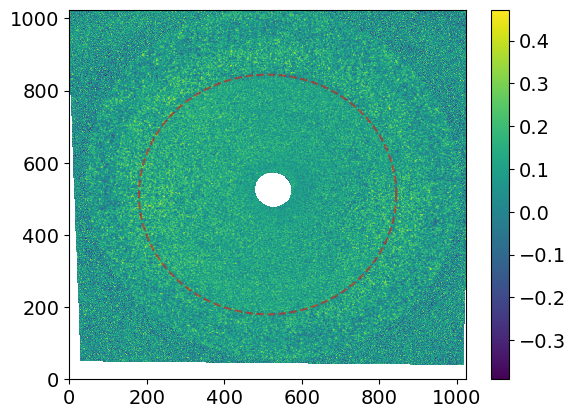

In [350]:
plt.pcolormesh(cor)
plt.plot((512+332*np.cos(phi_rad))/1, (512+332*np.sin(phi_rad))/1, 'r--', alpha = 0.5)
plt.colorbar()

In [ ]:
ll = np.copy(imsM[1])
ll[700:740,510:610] = 0
plt.pcolormesh(ll)

In [773]:
qqs = bgdat['quads'][0]
quads = make_quads(qqs)


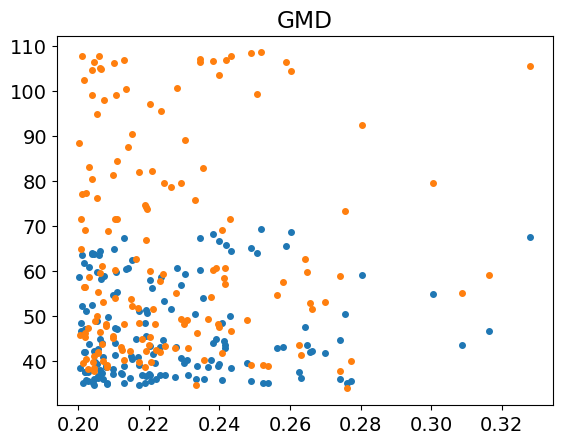

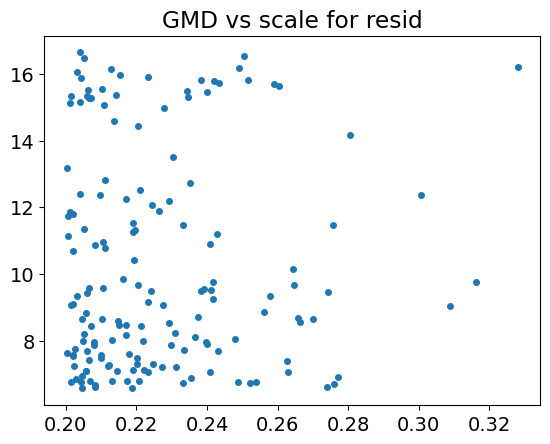

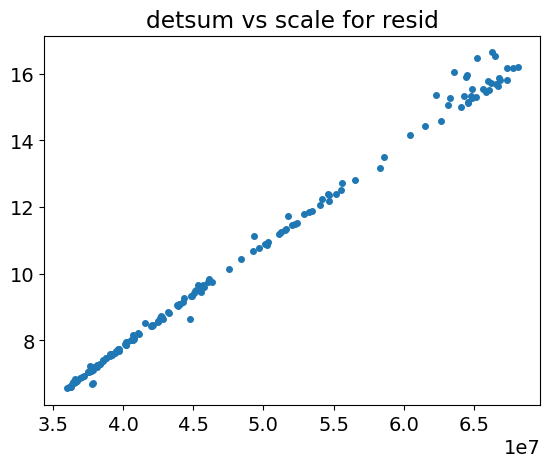

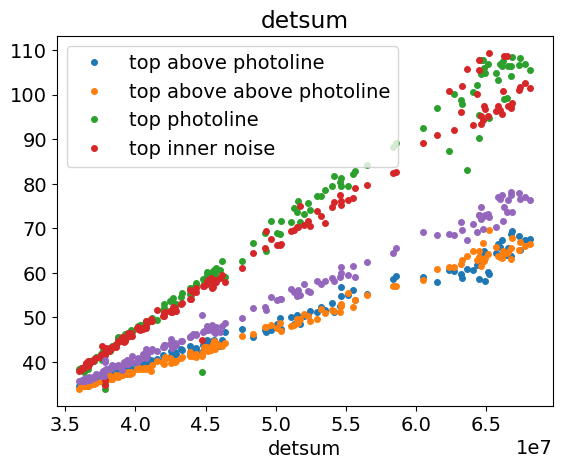

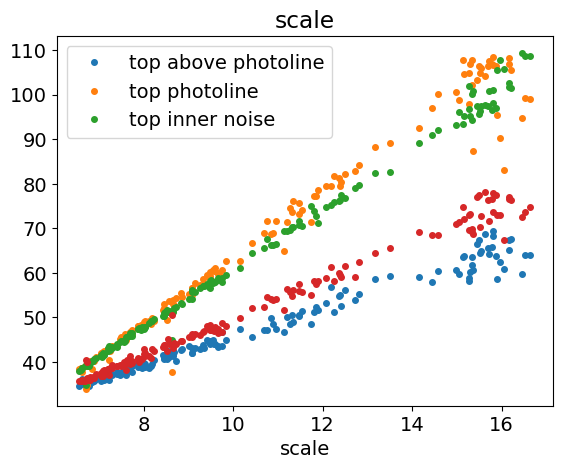

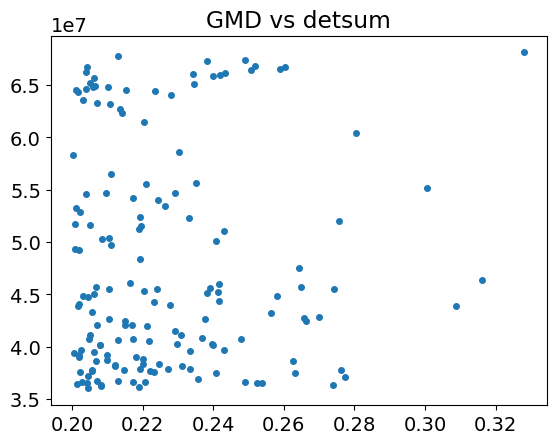

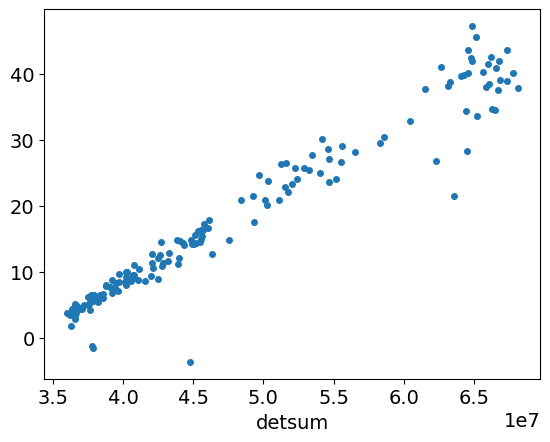

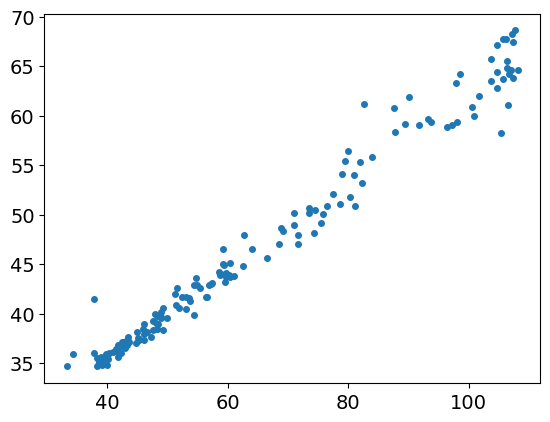

In [835]:
plt.plot(GDs_bg, np.mean(np.mean(imsM[:,850:890,510:610],axis = -1),axis = -1), 'o')
plt.plot(GDs_bg, np.mean(np.mean(imsM[:,790:830,510:610],axis = -1),axis = -1), 'o')
plt.title('GMD')
plt.show()


plt.plot(GDs_bg, scale, 'o')
plt.title('GMD vs scale for resid')
plt.show()


plt.plot(detsum, scale, 'o')
plt.title('detsum vs scale for resid')
plt.show()


plt.plot(detsum, np.mean(np.mean(imsM[:,850:890,510:610],axis = -1),axis = -1), 'o', label = 'top above photoline')
plt.plot(detsum, np.mean(np.mean(imsM[:,920:960,510:610],axis = -1),axis = -1), 'o', label = 'top above above photoline')
plt.plot(detsum, np.mean(np.mean(imsM[:,790:830,510:610],axis = -1),axis = -1), 'o', label = 'top photoline')
plt.plot(detsum, np.mean(np.mean(imsM[:,700:740,510:610],axis = -1),axis = -1), 'o', label = 'top inner noise')
#plt.plot(detsum, np.mean(np.mean(imsM[:,910:940,530:610],axis = -1),axis = -1), 'o')
plt.plot(detsum, np.mean(np.mean(imsM[:,134:174,510:610],axis = -1),axis = -1), 'o')
plt.xlabel('detsum')
plt.title('detsum')
plt.legend()
plt.show()

plt.plot(scale, np.mean(np.mean(imsM[:,850:890,510:610],axis = -1),axis = -1), 'o', label = 'top above photoline')
plt.plot(scale, np.mean(np.mean(imsM[:,790:830,510:610],axis = -1),axis = -1), 'o', label = 'top photoline')
plt.plot(scale, np.mean(np.mean(imsM[:,700:740,510:610],axis = -1),axis = -1), 'o', label = 'top inner noise')
#plt.plot(detsum, np.mean(np.mean(imsM[:,910:940,530:610],axis = -1),axis = -1), 'o')
plt.plot(scale, np.mean(np.mean(imsM[:,134:174,510:610],axis = -1),axis = -1), 'o')
plt.xlabel('scale')
plt.title('scale')
plt.legend()
plt.show()



plt.title('GMD vs detsum')
plt.plot(GDs_bg, detsum, 'o')
plt.show()


plt.plot(detsum, np.mean(np.mean(imsM[:,790:830,530:610],axis = -1),axis = -1)-np.mean(np.mean(imsM[:,850:890,530:610],axis = -1),axis = -1), 'o')
plt.xlabel('detsum')
plt.show()

plt.plot(np.mean(np.mean(imsM[:,790:830,530:610],axis = -1),axis = -1),np.mean(np.mean(imsM[:,850:890,530:610],axis = -1),axis = -1), 'o')

In [776]:
a1= np.mean(np.mean(imsM[:,850:890,510:610],axis = -1),axis = -1) # 'top above photoline')
a2 = np.mean(np.mean(imsM[:,790:830,510:610],axis = -1),axis = -1) # label = 'top photoline')

In [816]:
b1 = 10
b2= 125
print(a1[b1],a2[b1], scale[b1])
print(a1[b2],a2[b2], scale[b2])
print(a1[b2]*scale[b1]/scale[b2],a2[b2]*scale[b1]/scale[b2], scale[b2]*scale[b1]/scale[b2])
print(a1[b1]-a1[b2]*scale[b1]/scale[b2],a2[b1]-a2[b2]*scale[b1]/scale[b2])

36.09883251953126 37.7362177734375 6.615073684915842
47.321750488281246 71.58334179687499 10.947765126755257
28.593677591251158 43.253492846826404 6.615073684915842
7.505154928280099 -5.517275073388902


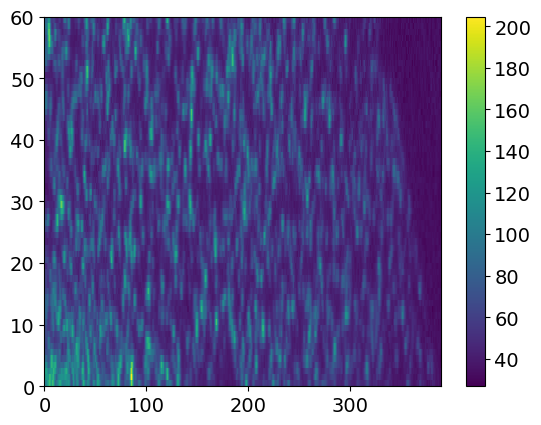

In [363]:
plt.pcolormesh(imsM[0][840:900,510:900])
plt.colorbar()

(array([22.,  9., 12.,  5.,  7.,  8.,  0.,  5., 12.,  6.]),
 array([37.011004 , 39.9186101, 42.8262162, 45.7338223, 48.6414284,
        51.5490345, 54.4566406, 57.3642467, 60.2718528, 63.1794589,
        66.087065 ]),
 <BarContainer object of 10 artists>)

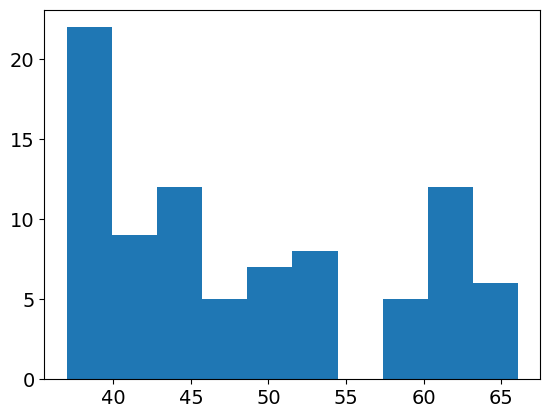

In [27]:
plt.hist(np.array(detsum)/1e6)

In [940]:
specs = np.array(specs)

In [941]:
def two_peaks(t, spec): 
    spec[spec<0] = 0
    spec = spec/np.max(spec)
    peakMax = np.max(spec)
    indMax = np.where(spec == peakMax)[0] 
    if len(indMax)>1: indMax = np.max(indMax)
    else: indMax = indMax[0]
    rollnum =  int(len(spec)/2) - indMax
    spec = np.roll(spec, rollnum)
    indMax = int(len(spec)/2)
    t1 = 0
    t2 = 0
    ind1 = 0
    ind2 = 0
    for i in range(int(len(t))):
        if t2 != 0 and t1 != 0:
            break
        if i < indMax:
            #print(i, np.trapz(spec[-i:]))
            
            if (spec[indMax-i] <= 0.5) & (t1 == 0):
                t1 = t[indMax-i]
                ind1 = indMax-i
            elif (spec[indMax+i] <= 0.5) & (t2 == 0):
                t2 = t[indMax+i]  
                ind2 = indMax+i
                
    spec = spec/np.sum(spec)
    area = np.trapz(spec[ind1:ind2]) #area in the FWHM
    return t2-t1, area, ind1-rollnum, ind2-rollnum

In [952]:
areas = []
for i in range(len(specs)):
    fw, area, ind1, ind2 = two_peaks(np.arange(len(specs[0])),specs[i])
    areas.append(area)
areas= np.array(areas)

(array([1., 1., 1., 2., 1., 4., 3., 0., 3., 1.]),
 array([0.46947744, 0.49452792, 0.5195784 , 0.54462888, 0.56967936,
        0.59472984, 0.61978032, 0.6448308 , 0.66988128, 0.69493176,
        0.71998224]),
 <BarContainer object of 10 artists>)

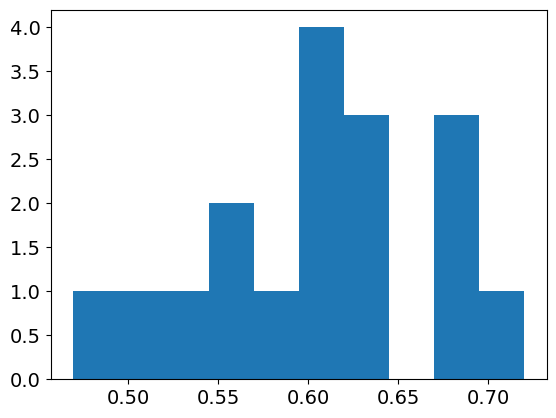

In [953]:
plt.hist(areas)

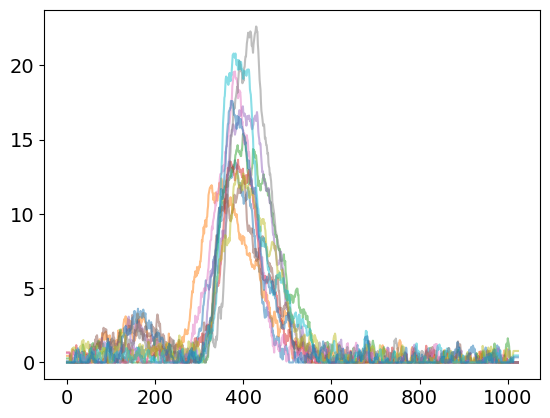

In [958]:
for n in np.where((0.6<np.array(areas)))[0]:
    plt.plot(specs[n], alpha = 0.5)


In [954]:
cen = []
for i in range(len(specs)):
    cen.append(get_centroidish(specs[i]))
    

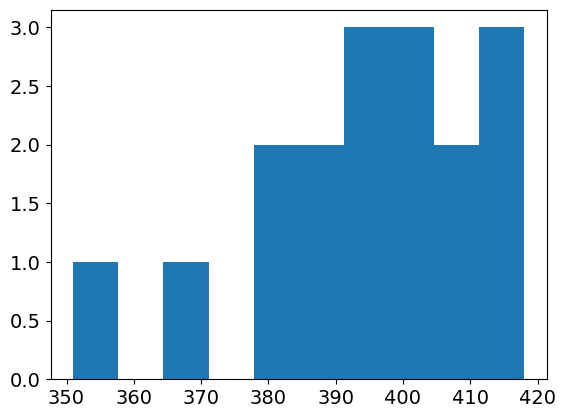

In [955]:
plt.hist(cen)
cen = np.array(cen)

In [956]:
specs = np.array(specs)

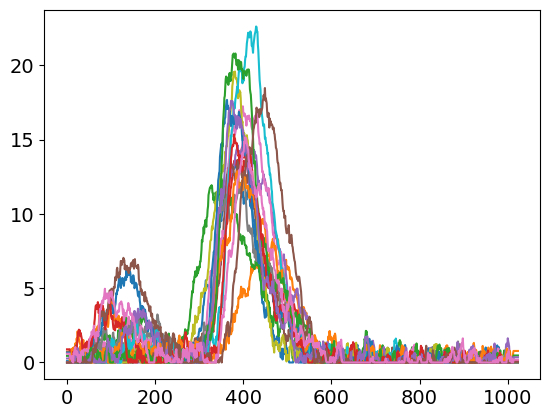

In [957]:
toplot = specs[cen>350]
for i in range(len(toplot)):
    plt.plot(toplot[i])

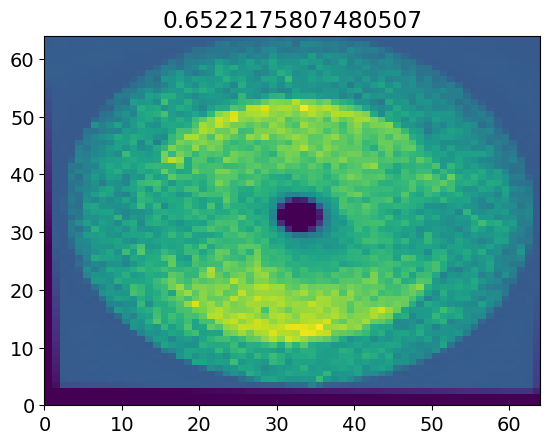

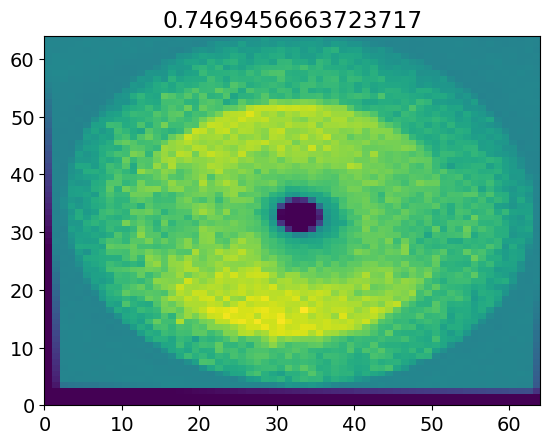

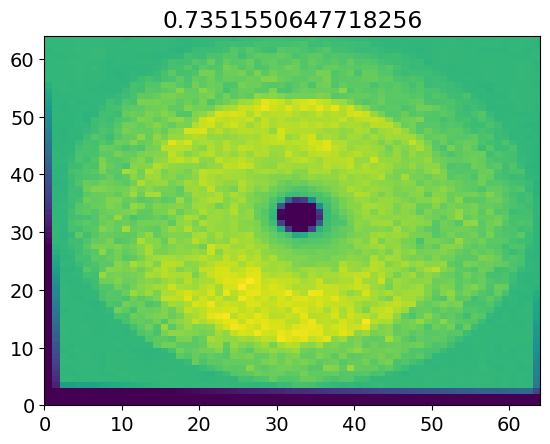

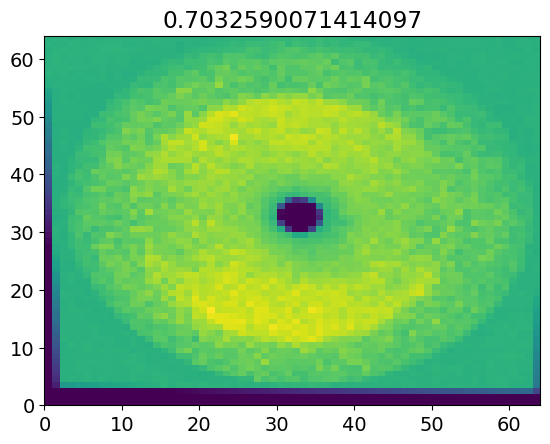

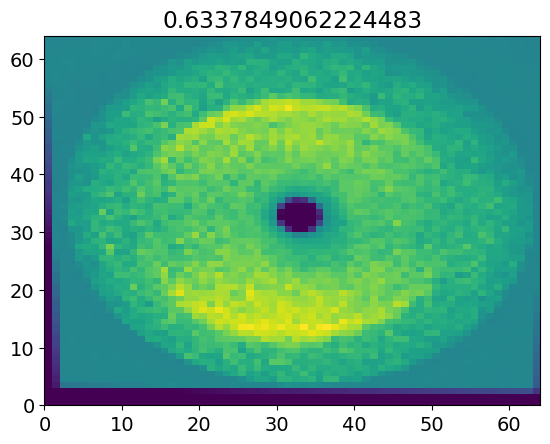

...

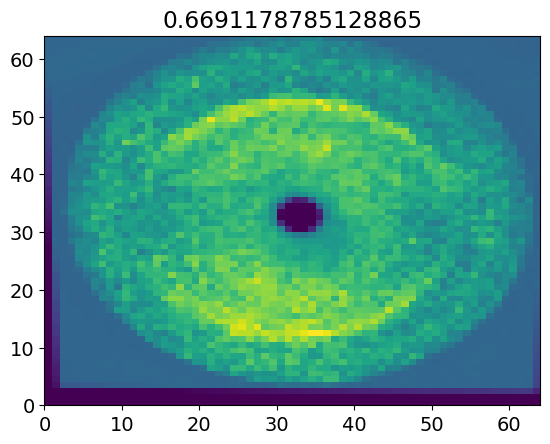

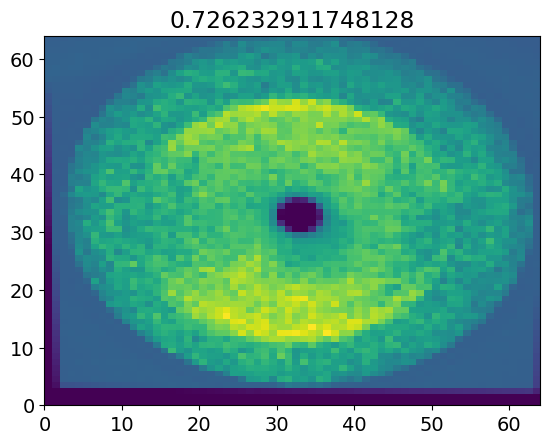

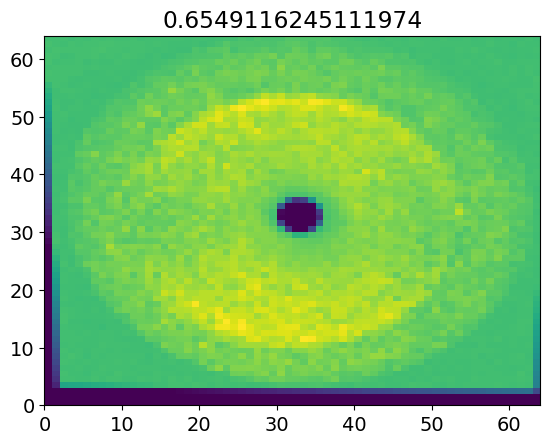

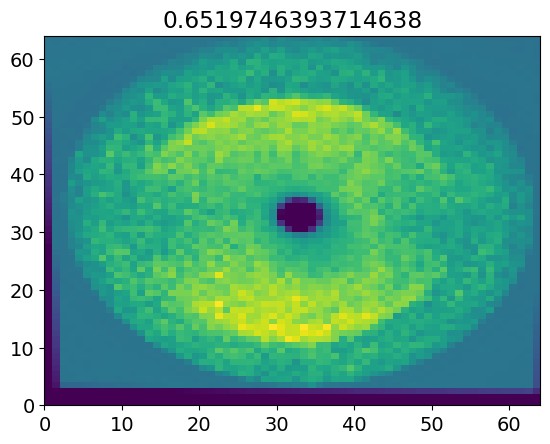

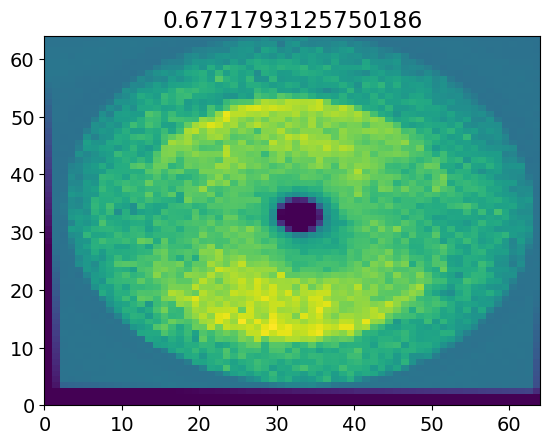

In [895]:
for i in range(len(imsM[cen>350])):
    plt.pcolormesh(rebin(rebin(imsM[cen>350][i],4),4))
    plt.title(areas[cen>350][i])
    plt.show()

In [960]:
lowP = np.mean(imsM[(0.6<np.array(areas))],axis = 0)

In [873]:
#np.save('innerring_resid112', rebin(rebin(gf(np.mean(imsM,axis = 0),15),4),4))

In [130]:
imsM = [cv2.warpPerspective(ii,MM,(1024,1024)) for ii in ims_bg]
imsM = np.array(imsM)
mean_unstreaked = np.mean(imsM, axis = 0)

In [53]:
bgdat = np.load('/cds/home/p/paris/cVMI/bgdat_run_112_Jul31.npy')
bins = bgdat['bins_maxim'] #bgdat['bins_maxim']    
binvar = maxim #detsum
bg_im = bgdat['bg_im_maxim'] #bgdat['bg_im_maxim'] #bgdat['bg_im']

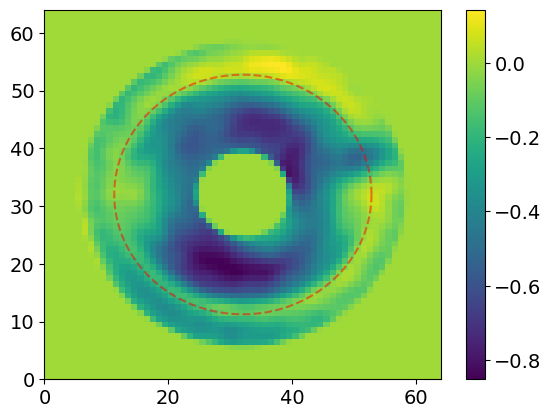

In [70]:
plt.pcolormesh(rebin(rebin(maskhm,4),4)*((bg_im[0]-np.mean(bg_im[0]))/np.std((bg_im[0]-np.mean(bg_im[0]))) - (bg_im[12]-np.mean(bg_im[12]))/np.std((bg_im[12]-np.mean(bg_im[12])))))#, vmin = 32)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()

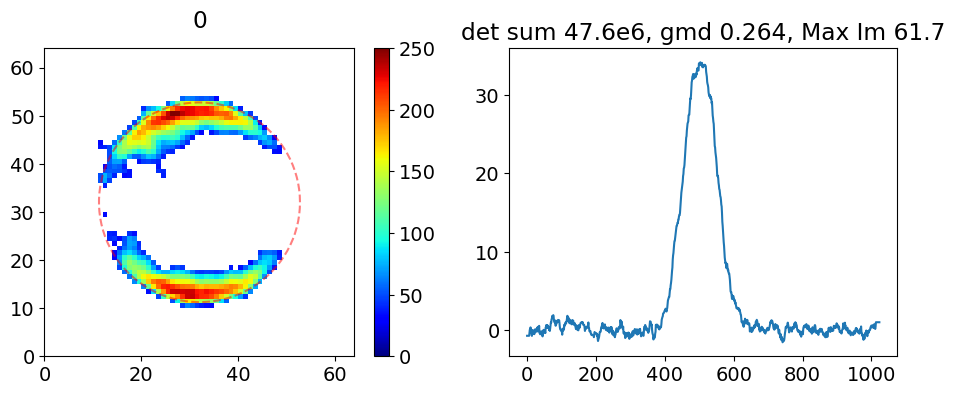

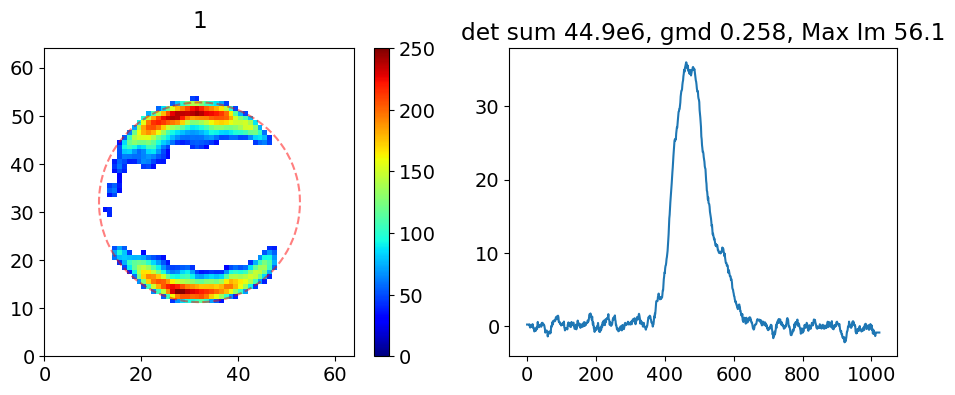

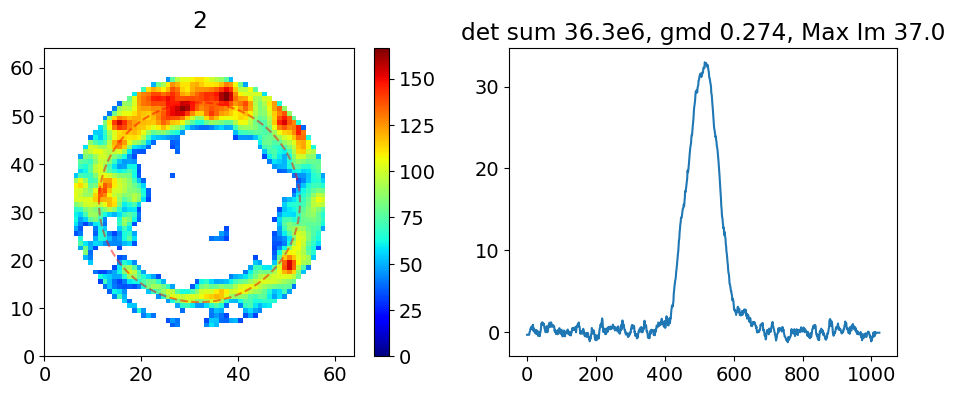

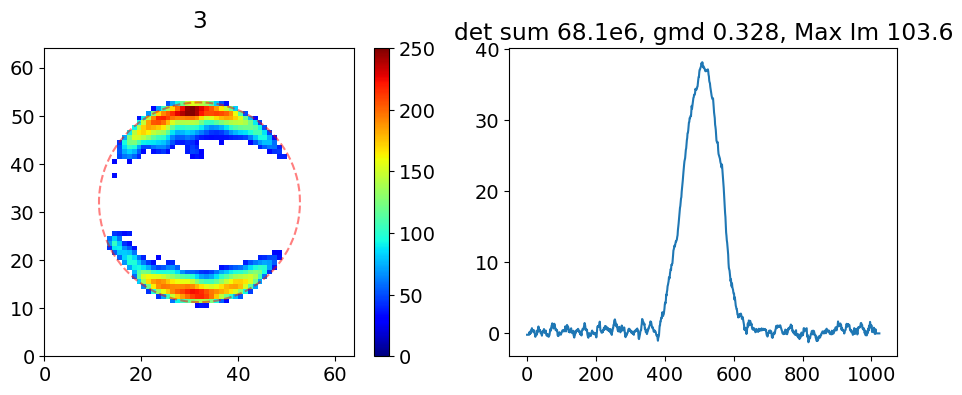

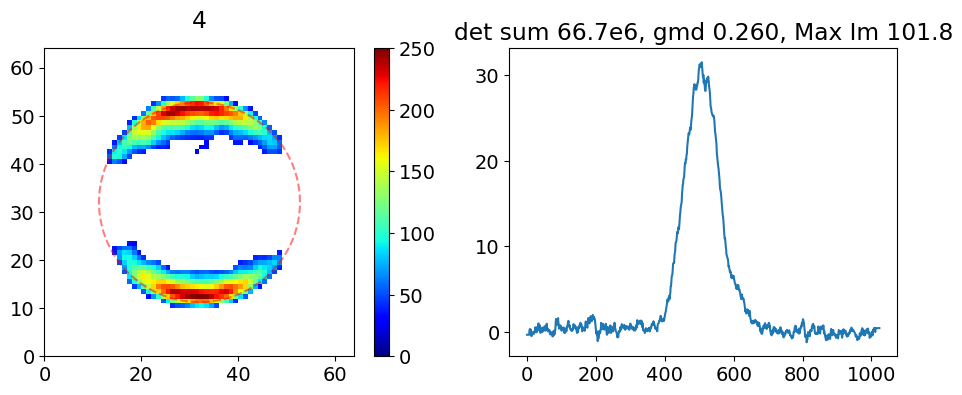

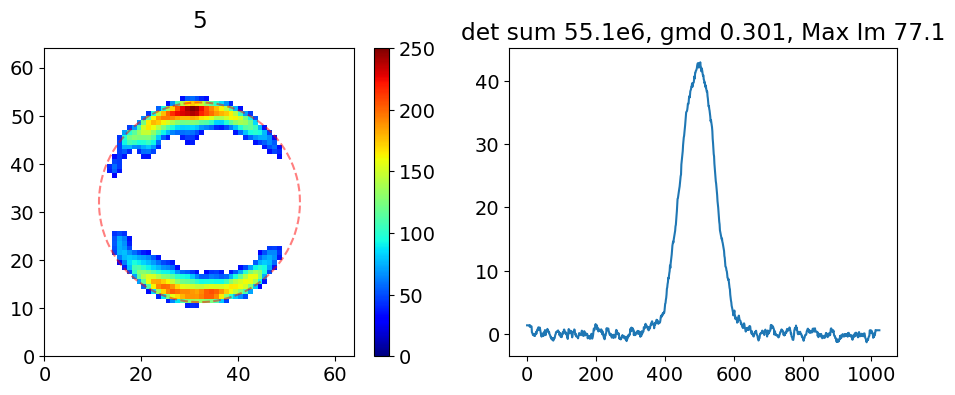

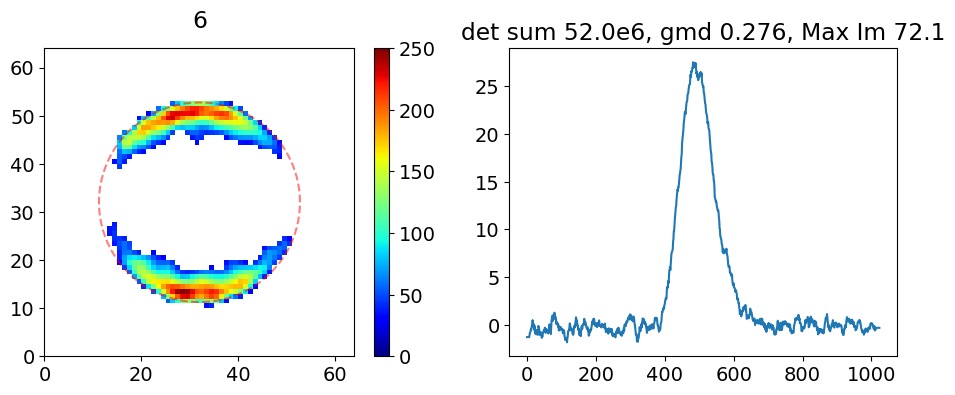

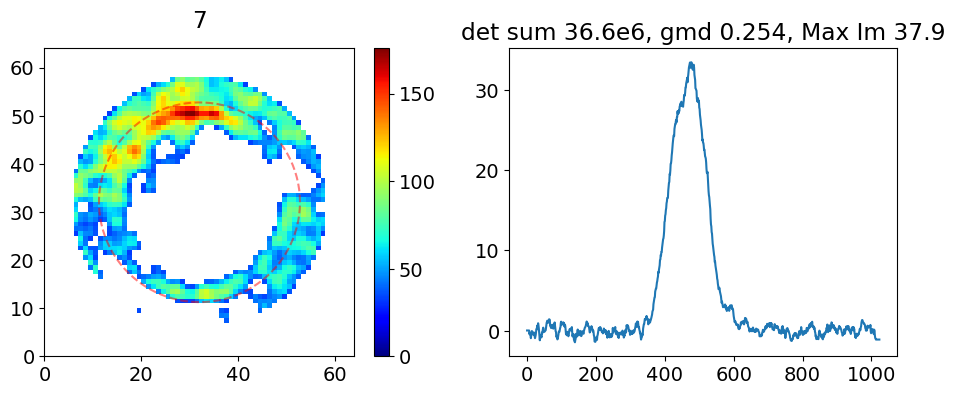

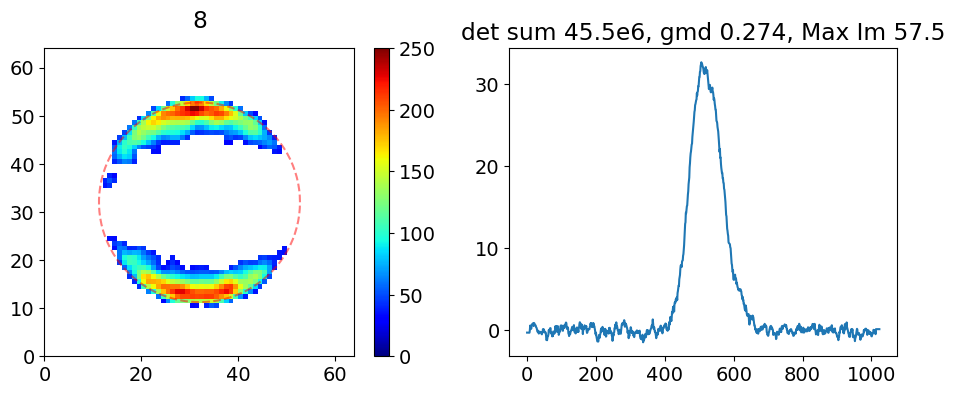

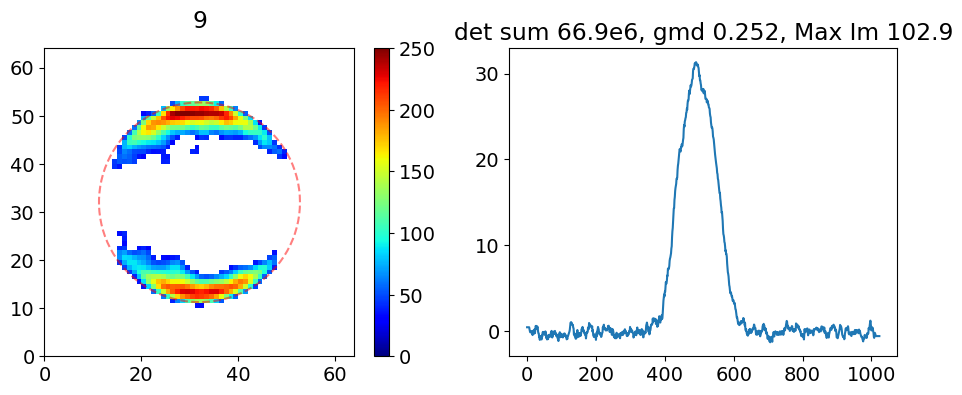

In [608]:
phi_rad = np.linspace(0,360,100)*np.pi/180
maxim = []
ims_proc = []

for i in range(10):
    binvar = np.max(rebin(rebin(imsM[i],4),4))
    idx = np.max((np.argmax(bins-binvar>0)-1, 0))
    idx = np.arange(np.max((0,idx-5)),np.min((12,idx+5)))
    #idx = np.arange(0,5)
    try:
        len(idx)
        resid = np.mean(bg_im[idx],axis = 0)
        qqs = np.mean(bgdat['quads'][idx],axis = 0)
    except: 
        qqs = bgdat['quads'][idx]
        resid = bg_im[idx]
    
    if 0 in [np.sum(qqss) for qqss in bgdat['quads'][idx]]: continue #need to fix this
    
    quads = make_quads(qqs)
    ims2 = imsM[i]*quads
    ims2 = mf(ims2, mfn)
    ims2 = gf(ims2, gfn)
    ims2= rebin(rebin(ims2,4),4)
    m = np.max(ims2) #when making dipole bg
    maxim.append(m)
    resid_scale = resid/np.mean(resid*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))
#     x = (ims2*rebin(rebin(maskscale,4),4) - np.mean(ims2*rebin(rebin(maskscale,4),4)))
#     resid_scale = (resid-np.mean(resid*rebin(rebin(maskscale,4),4)))/np.std((resid-np.mean(resid*rebin(rebin(maskscale,4),4))))*np.std(x) + np.mean(ims2*rebin(rebin(maskscale,4),4))
    

    ims2 = ims2 - resid_scale
    ims2 = gf(ims2,.25)
   
    
    ims2 = ims2*rebin(rebin(maskhm,4),4)*250/np.max(ims2)
    ims2[ims2<thresh] = 0
    fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (11,4))
    p = axs[0].pcolormesh(ims2, cmap = my_cmap)
    ims_proc.append(ims2)
    plt.colorbar(p, ax = axs[0])
    axs[0].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    axs[1].plot(specs[i])
    plt.title('det sum %1.1fe6, gmd %1.3f, Max Im %1.1f' %(np.sum(detsum[i]/1e6), GDs_bg[i], m))
    #axs[0].set_title('%1.0f - %1.0f' %(bins[np.argmax(bins-detsum[i]>0)-1]/1e6,bins[np.argmax(bins-detsum[i]>0)-1+1]/1e6), y = 1.04)
    axs[0].set_title('%1.0f' %(i), y = 1.04)
    #plt.colorbar()
    plt.show()
    
    
#     ##maskscale
#     m = np.max(ims2) #when making dipole bg
#     resid_scale = resid/np.mean(resid*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))

#     ims2 = ims2 - resid_scale
#     ims2 = gf(ims2,.25)
   
    
#     ims2 = ims2*rebin(rebin(maskhm,4),4)*250/np.max(ims2)
#     ims2[ims2<thresh] = 0
#     fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (11,4))
#     p = axs[0].pcolormesh(ims2, cmap = my_cmap)
#     plt.colorbar(p, ax = axs[0])
#     axs[0].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
#     axs[1].plot(specs[i])
#     plt.title('with maskscale, det sum %1.1fe6, gmd %1.3f, Max Im %1.1f' %(np.sum(detsum[i]/1e6), GDs_bg[i], m))
#     axs[0].set_title('%1.0f - %1.0f' %(bins[np.argmax(bins-detsum[i]>0)-1]/1e6,bins[np.argmax(bins-detsum[i]>0)-1+1]/1e6), y = 1.04)
#     #plt.colorbar()
#     plt.show()

In [ ]:
len(ims_proc), len(specs), len(GDs_bg)

In [27]:
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Jul30_112_0.npy',imsM[:10])
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Jul30_112_0.npy',specs[:10])
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/GDs_Jul30_112_0.npy',GDs_bg[:10])


Text(0.5, 1.0, '112')

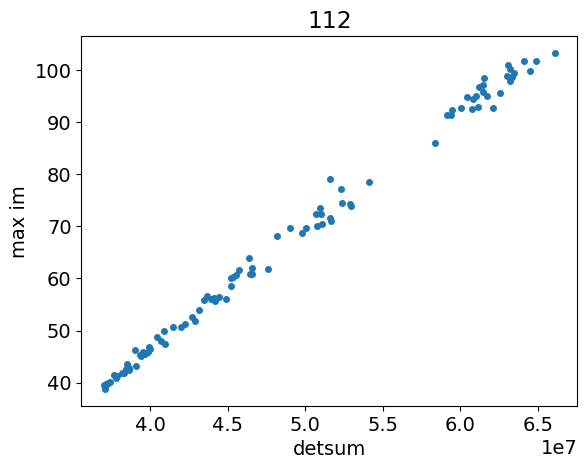

In [45]:
plt.plot(detsum[:len(maxim)],maxim, 'o')
plt.xlabel('detsum')
plt.ylabel('max im')
plt.title('112')

In [912]:
tt = np.array([4410466500189199731, 4410466526673217253, 4410466573846689349,
       4410466594902752439, 4410466616733582400, 4410466625389315880,
       4410466638006438656, 4410466651198312359, 4410466654584819656,
       4410466668401644880, 4410466684855376363, 4410466715076649980,
       4410466715459904646, 4410466745388756526, 4410466749616615294,
       4410466750007996427, 4410466753627943040, 4410466762749899792,
       4410466860991124424, 4410466861457740912, 4410466865519007108,
       4410467363985340688], dtype=np.uint64)

In [913]:
exp =  "tmox51020"
ds = ps.DataSource(exp=exp, run=runnum, timestamps=tt)
run = next(ds.runs())

if hasattr(run, 'epicsinfo'):
    epics_strs = [item[0] for item in run.epicsinfo.keys()][1:] # first one is weird
    epics_detectors = [run.Detector(item) for item in epics_strs]    


# specify detectors here
opal1 = run.Detector('tmo_opal1') # OPAL camera looking at the holey mirror
gmd = run.Detector("gmd") # gas intensity detector 
xgmd = run.Detector("xgmd") # gas intensity detector 
timing = run.Detector('timing') # this gives access to evr codes
ebeam = run.Detector("ebeam")
opalfzp = run.Detector('tmo_fzpopal') 



ims_bg = [] # initialize the list of example images here
GDs_bg = []
xGDs_bg = []
detsum = []
uppersum = []
maxim = []
specs = []
jet_timing_bg = []


for nevent, event in enumerate(run.events()): # loop over events (shots) in the run

    # fetch the information from the different events
    opal1im_i=np.copy(opal1.raw.raw(event))
    #opal1im_i=np.copy(opal1.raw.image(event)) #doesn't work since update
    gd_i=gmd.raw.energy(event)
    xgd_i=xgmd.raw.energy(event)


    ims = np.rot90(opal1im_i*mask)
    #ims = ims/np.sum(ims)
    #ims = cv2.warpPerspective(ims,MM,(1024,1024))
    #ims_bg.append(ims[100:900,100:900])
    detsum.append(np.sum(ims))
    ims_bg.append(ims)
    GDs_bg.append(gd_i)
    xGDs_bg.append(xgd_i)
    uppersum.append(np.sum(ims*maskhole))
    maxim.append(np.max(rebin(rebin(ims,4),4)))
   # jet_timing_bg.append(data['epics_evr_ch0_delay'])

    opalfz= np.copy(opalfzp.raw.image(event)) #np.copy(opal1.raw.image(event)) #np.copy(opal1.raw.raw(event))
    zps_data = opalfz
    zps_pixel = 100+np.argmax(np.sum(zps_data[100:900],axis=1))
    px_2d_width = 25 #spacing to cut the 2d image slice to store. Typically 50 pixel width. 25 on either side
    px_edge_width = 5 #spacing to integrate for the line out. 

    zps_2d = zps_data[zps_pixel-px_2d_width:zps_pixel+px_2d_width][:]
    zps = zps_data[zps_pixel-px_edge_width:zps_pixel+px_edge_width][:].mean(0)#
    zps_bg = zps_data[zps_pixel-px_2d_width:zps_pixel-px_2d_width+px_edge_width][:].mean(0)#
    zps = zps-zps_bg
    spec = np.squeeze(fastsmooth1(zps,10))
    spec = np.array(np.squeeze(spec) - np.mean(np.squeeze(spec)[800:900])) 
    specs.append(spec)
        
    print(event.timestamp)   

4410466500189199731
4410466526673217253
4410466573846689349
4410466594902752439
4410466616733582400
4410466625389315880
4410466638006438656
4410466651198312359
4410466654584819656
4410466668401644880
4410466684855376363
4410466715076649980
4410466715459904646
4410466745388756526
4410466749616615294
4410466750007996427
4410466753627943040
4410466762749899792
4410466860991124424
4410466861457740912
4410466865519007108
4410467363985340688


In [14]:
len(detsum)

22

In [232]:
mdat= np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Mar12_112.npy', allow_pickle = True)[()]
specdat = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Mar12_112.npy', allow_pickle = True)[()]

In [914]:
imsM = [cv2.warpPerspective(ii,MM,(1024,1024)) for ii in ims_bg]
imsM = np.array(imsM)
# bgdat = np.load('/cds/home/p/paris/cVMI/bgdat_run_112_Jul30.npy')
# bins = bgdat['bins_maxim']    
# binvar = maxim #detsum
# bg_im = bgdat['bg_im_maxim'] #bgdat['bg_im']
bgdat = np.load('/cds/home/p/paris/cVMI/bgdat_run_112_Jul31.npy')
bins = bgdat['bins_maxim'] #bgdat['bins_maxim']    
binvar = maxim #detsum
bg_im = bgdat['bg_im_maxim'] #bgdat['bg_im_maxim'] #bgdat['bg_im']

In [77]:
residold = np.load('/cds/home/p/paris/reconVMI_clean/recon X510 Jan/bg_run_112_Mar.npy')
quadsold = cv2.warpPerspective(make_quads([0.97,0.967,0.99,0.999]),MM,(1024,1024))

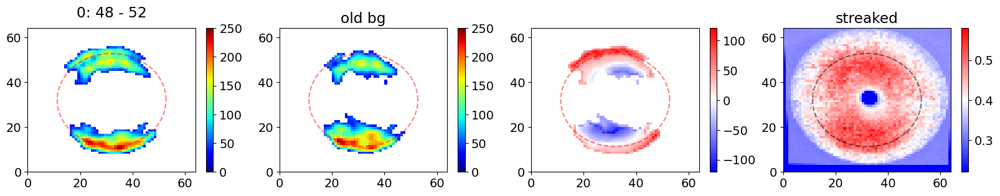

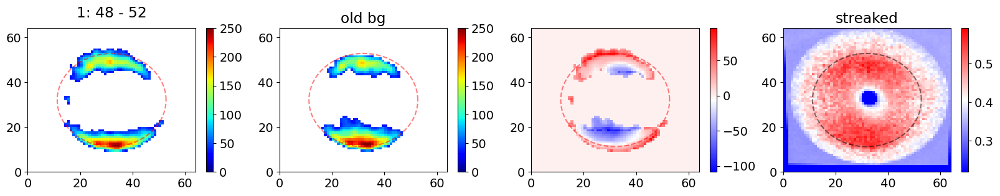

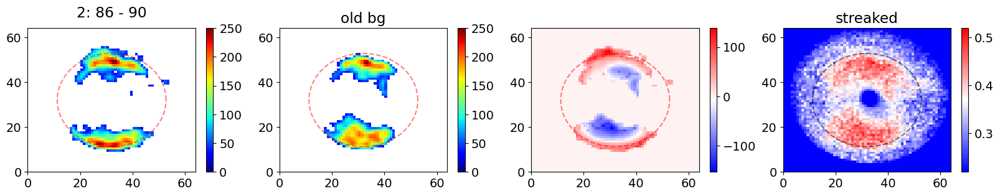

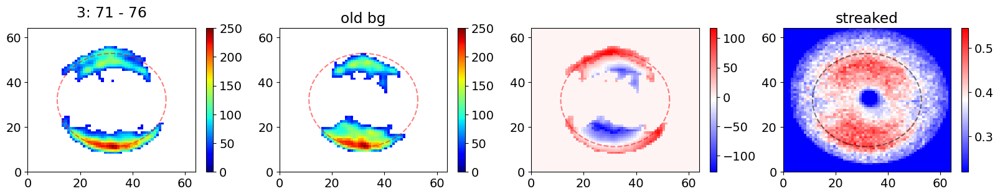

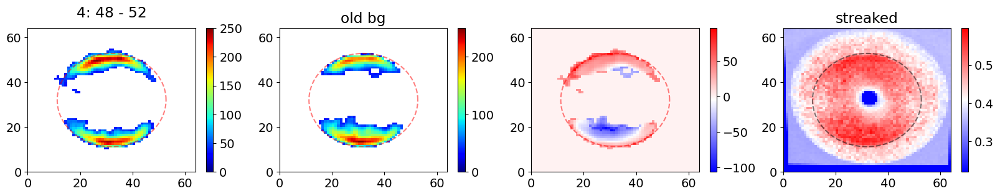

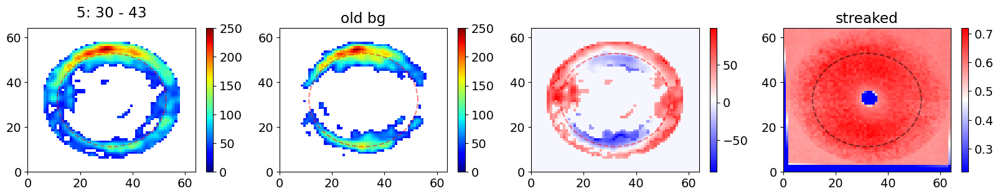

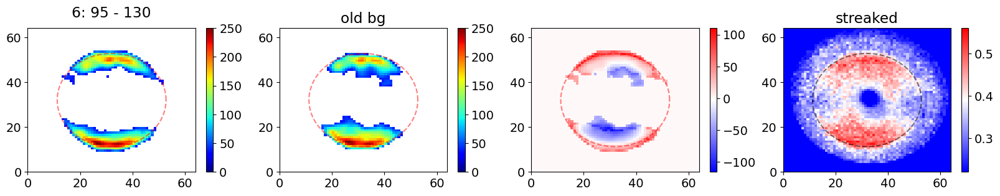

KeyboardInterrupt: 

In [162]:
phi_rad = np.linspace(0,360,100)*np.pi/180
msnew = []
for i in range(len(imsM)):
    binvar = np.max(rebin(rebin(imsM[i],4),4))
    idx = np.max((np.argmax(bins-binvar>0)-1, 0))
    idx = np.arange(np.max((0,idx-5)),np.min((12,idx+5)))
    #idx = np.arange(0,5)
    try:
        len(idx)
        resid = np.mean(bg_im[idx],axis = 0)
        qqs = np.mean(bgdat['quads'][idx],axis = 0)
        
    except: 
        qqs = bgdat['quads'][idx]
        resid = bg_im[idx]
    
    if 0 in [np.sum(qqss) for qqss in bgdat['quads'][idx]]: continue #need to fix this
    
    quads = make_quads(qqs)
    ims2 = imsM[i]*quads
    ims2 = mf(ims2, mfn)
    ims2 = gf(ims2, gfn)
    ims2= rebin(rebin(ims2,4),4)
    m = np.max(ims2) #when making dipole bg
    resid_scale = resid/np.mean(resid*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))

    ims2 = ims2 - resid_scale
    #ims2 = gf(ims2,.25)

    ims2 = ims2*rebin(rebin(maskhm,4),4)*250/np.max(ims2)
    ims2[ims2<thresh] = 0
    fig,axs = plt.subplots(nrows = 1, ncols = 4, figsize = (20,3))
    p = axs[0].pcolormesh(ims2, cmap = my_cmap)
    plt.colorbar(p, ax = axs[0])
    axs[0].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    #axs[3].plot(specs[i])
    #axs[3].plot(specdat[i], '--')
    plt.title('det sum %1.1fe6, gmd %1.3f, Max Im %1.1f' %(np.sum(detsum[i]/1e6), GDs_bg[i], m))
    axs[0].set_title('%1.0f: %1.0f - %1.0f' %(i, bins[np.argmax(bins-m>0)-1],bins[np.argmax(bins-m>0)-1+1]), y = 1.04)
    
    imsold = imsM[i]*quadsold
    imsold = mf(imsold, mfn)
    imsold = gf(imsold, gfn)
    imsold= rebin(rebin(imsold,4),4)
    resid_scale = residold/np.mean(residold*rebin(rebin(maskscale,4),4))*np.mean(imsold*rebin(rebin(maskscale,4),4))

    imsold = imsold - resid_scale
    #ims2 = gf(ims2,.25)

    imsold= imsold*rebin(rebin(maskhm,4),4)*250/np.max(imsold)
    imsold[imsold<thresh] = 0
    
    
    p = axs[1].pcolormesh(imsold, cmap = my_cmap)
    plt.colorbar(p, ax = axs[1])
    axs[1].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    axs[1].set_title('old bg')
    
    p = axs[2].pcolormesh(ims2 - imsold, cmap = 'bwr')
    msnew.append(ims2)
    plt.colorbar(p, ax = axs[2])
    axs[2].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    
    
    ims2 = imsM[i]*quads
    #ims2 = ims2*maskhm/np.sum(ims2*maskhm) - mean_unstreaked*quads*maskhm/np.sum(mean_unstreaked*quads*maskhm)
    ims2 = ims2/np.sum(ims2)# - mean_unstreaked*quads/np.sum(mean_unstreaked*quads)
    #ims2 = ims2-np.mean(ims2) - (mean_unstreaked*quads-np.mean(mean_unstreaked*quads))
    exp = np.log10(np.max(ims2))
    
    p = axs[3].pcolormesh(rebin(rebin(ims2,4),4)/(10**exp), cmap = 'bwr', vmin = 0.22) #, vmin = -0.4, vmax = 0.4)
    
    plt.colorbar(p, ax = axs[3])
    axs[3].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'k--', alpha = 0.5)
    axs[3].set_title('streaked')# - unstreaked')

    plt.show()

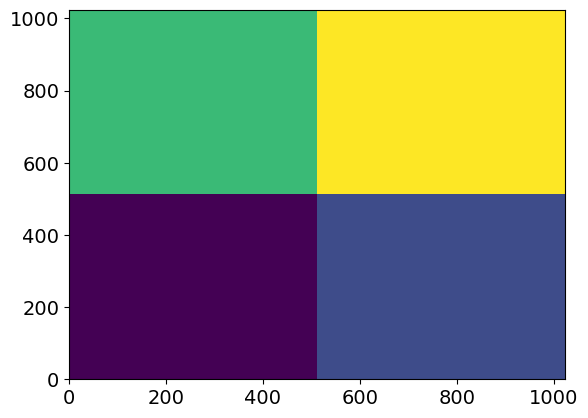

In [169]:
plt.pcolormesh(quads)

In [ ]:
plt.plot(specs[i])

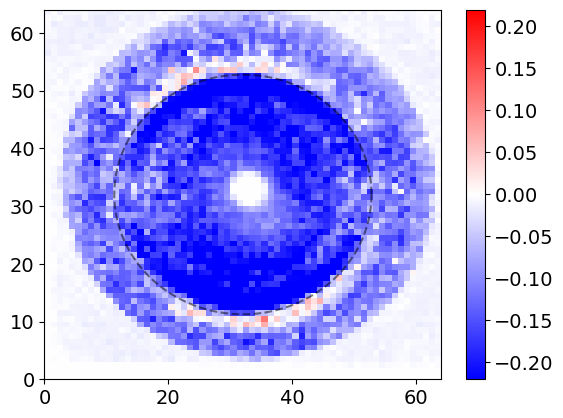

In [91]:
i = 0
ims2 = imsM[i]*quads
#ims2 = ims2*maskhm/np.sum(ims2*maskhm) - mean_unstreaked*quads*maskhm/np.sum(mean_unstreaked*quads*maskhm)
ims2 = ims2/np.sum(ims2) - mean_unstreaked*quads/np.sum(mean_unstreaked*quads)
#ims2 = ims2-np.mean(ims2) - (mean_unstreaked*quads-np.mean(mean_unstreaked*quads))
exp = np.log10(np.max(ims2))
plt.pcolormesh(rebin(rebin(ims2,4),4)/(10**exp), cmap = 'bwr', vmin = -0.22, vmax = 0.22)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'k--', alpha = 0.5)
plt.colorbar()

In [145]:
mean_unstreaked2 = np.mean(imsM[cen<420],axis = 0)

In [135]:
mean_unstreaked3 = np.mean(imsM[cen>520],axis = 0)

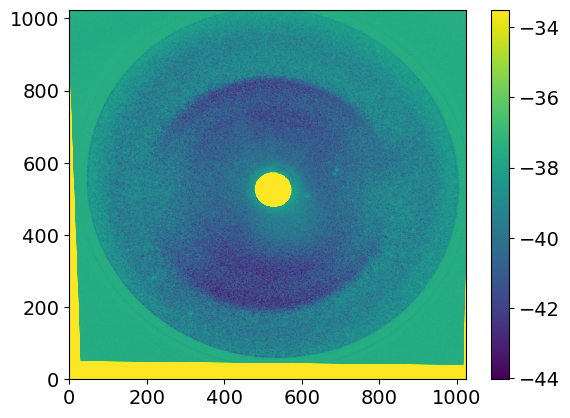

In [234]:
plt.pcolormesh(ims2)
plt.colorbar()

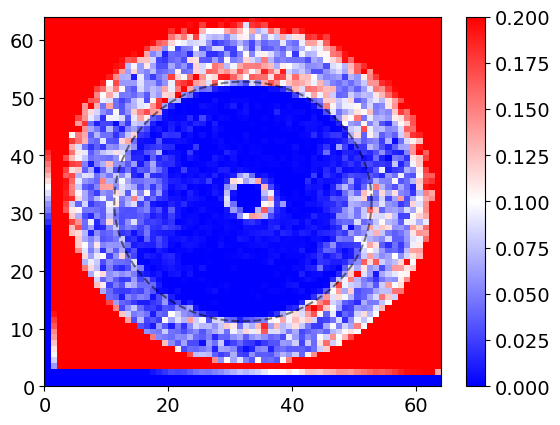

In [272]:
i = 0
ims2 = imsM[i]#*quads
#ims2 = ims2*maskhm/np.sum(ims2*maskhm) - mean_unstreaked*quads*maskhm/np.sum(mean_unstreaked*quads*maskhm)
#unstr = mean_unstreaked*quads/np.sum(mean_unstreaked*quads)
#unstr = (unstr+np.flipud(unstr))/2
unstr = x + np.mean(ims2)
unstr[unstr<0] = 0 # mean_unstreaked2/np.sum(mean_unstreaked2)
ims2 = ims2 - unstr
#ims2 = ims2-np.mean(ims2) - (mean_unstreaked*quads-np.mean(mean_unstreaked*quads))
exp = np.log10(np.max(ims2))
ims2[ims2<0] = 0
plt.pcolormesh(rebin(rebin(ims2,4),4)/(10**exp), cmap = 'bwr' ,  vmax = 0.2) #, vmin = -0.4, vmax = 0.4)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'k--', alpha = 0.5)
plt.colorbar()

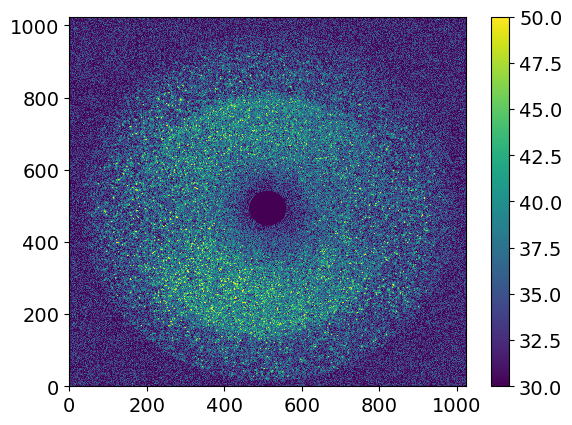

In [576]:
plt.pcolormesh(ims,vmax = 50, vmin = 30)
plt.colorbar()

In [900]:
quads = make_quads([1,1,1,1])
quads

array([[1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       ...,
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.],
       [1., 1., 1., ..., 1., 1., 1.]])

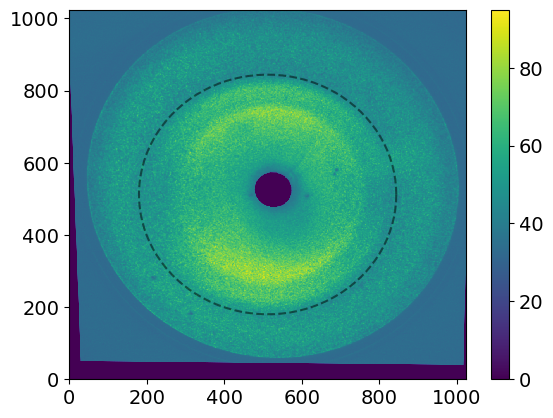

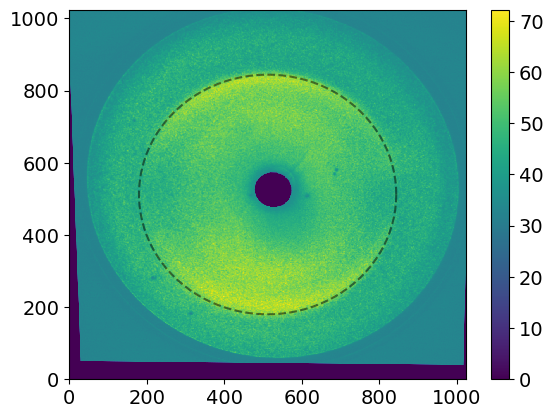

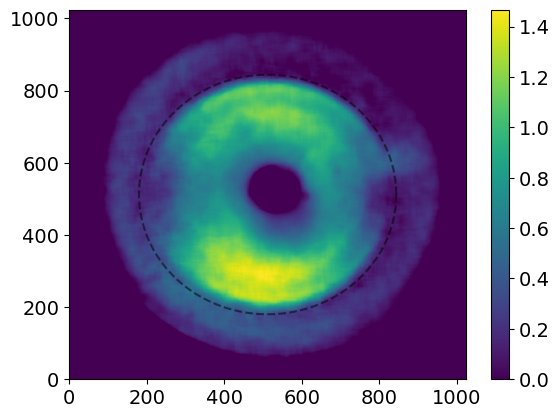

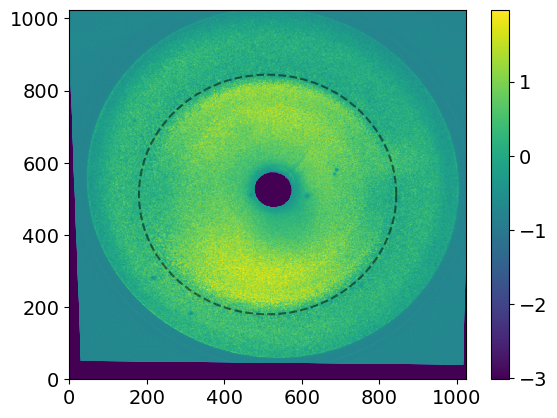

In [972]:
# cen3  = mean_unstreaked3-np.mean(mean_unstreaked3)
# cen3[cen3 < 0 ] = 0
# cen2  = mean_unstreaked2-np.mean(mean_unstreaked2)
# cen2[cen2 <0] = 0
# x =  (cen3 + cen2 - np.abs(cen3-cen2))/2
# x = x*quads

#incorect scaling


cen3  = smallP #lowP #smallP #mean_unstreaked3
cen2  = highP #mean_unstreaked2
plt.pcolormesh(cen3)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad)), (512+332*np.sin(phi_rad))/1, 'k--', alpha = 0.5)
plt.show()
plt.pcolormesh(cen2)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad)), (512+332*np.sin(phi_rad))/1, 'k--', alpha = 0.5)
plt.show()

# cen2 = cen2/np.mean(cen2*maskscale)*np.mean(cen3*maskscale)
# x =  (cen3 + cen2 - np.abs(cen3-cen2))/2
# #x = x #*quads

cen3  = cen3-np.mean(cen3)
cen3 = cen3/np.std(cen3)
cen2  = cen2-np.mean(cen2)
cen2 = cen2/np.std(cen2)
x =  (cen3 + cen2 - np.abs(cen3-cen2))/2


xx = np.copy(x)
xx[xx<0] = 0
plt.pcolormesh(mf(xx,25))
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad)), (512+332*np.sin(phi_rad))/1, 'k--', alpha = 0.5)
plt.show()

plt.pcolormesh(x)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad)), (512+332*np.sin(phi_rad))/1, 'k--', alpha = 0.5)


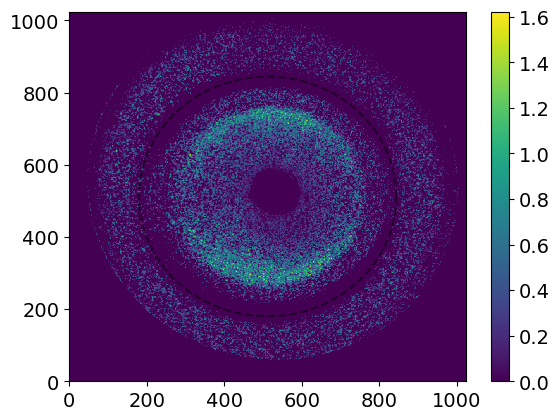

In [986]:
plt.pcolormesh(cen3 - xx, vmin = 0)
plt.plot((512+332*np.cos(phi_rad)), (512+332*np.sin(phi_rad))/1, 'k--', alpha = 0.5)
plt.colorbar()

(array([ 66238.,    601.,    620.,  60717., 235157., 246655., 234705.,
        140989.,  59346.,   3548.]),
 array([ 0.        ,  8.1652643 , 16.33052861, 24.49579291, 32.66105721,
        40.82632152, 48.99158582, 57.15685012, 65.32211443, 73.48737873,
        81.65264303]),
 <BarContainer object of 10 artists>)

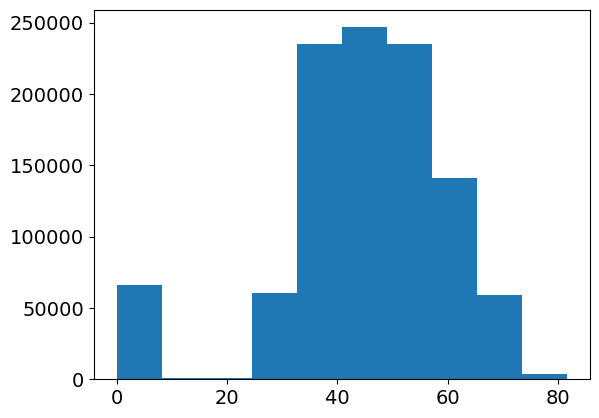

In [904]:
plt.hist(x.flatten())

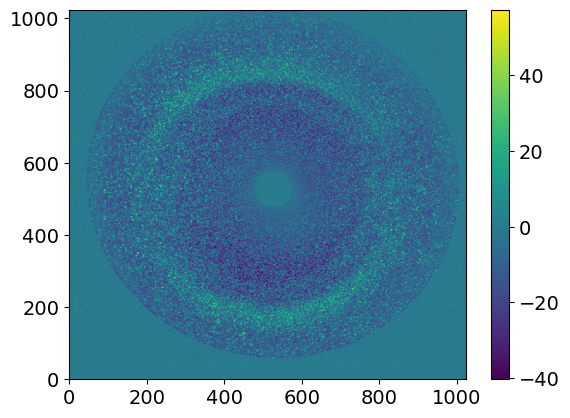

In [915]:
plt.pcolormesh(imsM[0]-x)
plt.colorbar()

In [ ]:
i = 18
ims2 = imsM[0]* quads #mean_unstreaked3*quads #imsM[i]*quads
ims2 = mf(ims2, mfn)
ims2 = gf(ims2, gfn)
ims2= rebin(rebin(ims2,4),4)
ims3 = np.copy(ims2)*rebin(rebin(maskhm,4),4)
ims3[ims3<=0] = np.nan
ims2 = (ims2 - np.nanmean(ims3))*100
ims2[ims2<0] = 0
resid_scale = rebin(rebin(gf(mf(x,mfn),gfn),4),4)
resid_scale = (resid_scale - np.mean(resid_scale))*100
resid_scale[resid_scale<0] = 0
resid_scale = resid_scale/np.mean(resid_scale*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))

In [ ]:
fig,axs = plt.subplots(nrows = 1, ncols = 2, figsize = (11,4))
p = axs[1].pcolormesh(ims2)
plt.colorbar(p, ax = axs[1])
p = axs[0].pcolormesh(resid_scale, vmin = np.min(ims2), vmax = np.max(ims2))
plt.colorbar(p, ax = axs[0])

In [ ]:
plt.pcolormesh(ims2 - resid_scale, vmin = 0)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()

ims3 = np.copy(ims2)*rebin(rebin(maskhm,4),4)
ims3[ims3<=0] = np.nan

plt.pcolormesh(ims2 - np.nanmean(ims3), vmin = 0)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()

In [684]:
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
masktest=np.zeros((1024,1024))
masktest[(rs>330)]=1



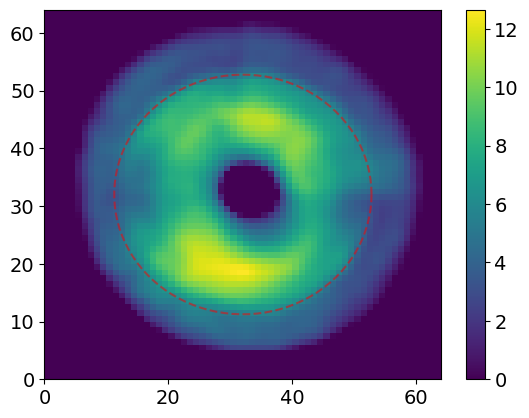

In [697]:
bg_im = bgdat['bg_im_maxim']
i = 4
plt.pcolormesh(bg_im[i]-np.mean(bg_im[i]), vmin = 0) #*(rebin(rebin(masktest,4),4)), vmin = 30, vmax= 34)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)

plt.colorbar()

(array([1345.,   35.,   30.,   16.,   10.,   12.,   20.,   17.,   14.,
          24.,   23.,   16.,   15.,   15.,   20.,   17.,   12.,   26.,
          38.,   18.,   30.,  150.,  629.,  151.,  167.,  173.,  193.,
         448.,  366.,   66.]),
 array([ 0.        ,  1.36428643,  2.72857286,  4.0928593 ,  5.45714573,
         6.82143216,  8.18571859,  9.55000502, 10.91429145, 12.27857789,
        13.64286432, 15.00715075, 16.37143718, 17.73572361, 19.10001004,
        20.46429648, 21.82858291, 23.19286934, 24.55715577, 25.9214422 ,
        27.28572863, 28.65001507, 30.0143015 , 31.37858793, 32.74287436,
        34.10716079, 35.47144722, 36.83573366, 38.20002009, 39.56430652,
        40.92859295]),
 <BarContainer object of 30 artists>)

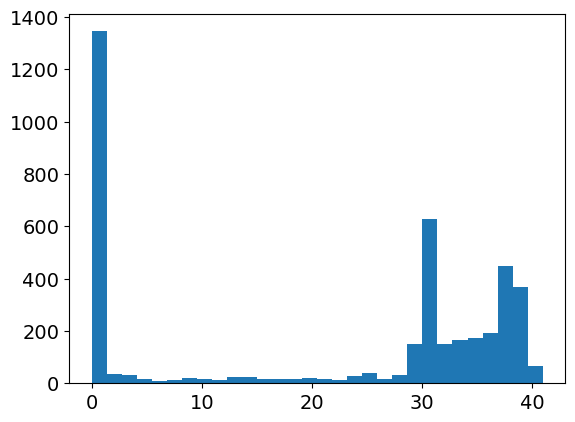

In [691]:
plt.hist((bg_im[4]*(rebin(rebin(masktest,4),4))).flatten(), bins = 30)

In [630]:
xx = np.copy(x)
xx[xx<0] = 0
ims2 = ims2
resid_scale = rebin(rebin(gf(mf(xx,mfn),gfn),4),4)
resid_scale[resid_scale<0] = 0
resid_scale = resid_scale/np.mean(resid_scale*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))

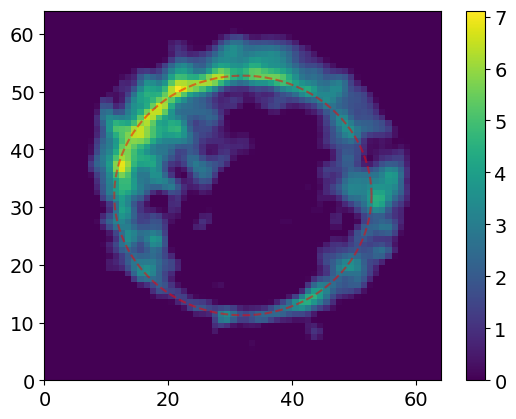

In [631]:
plt.pcolormesh(ims2 - resid_scale, vmin = 0)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()



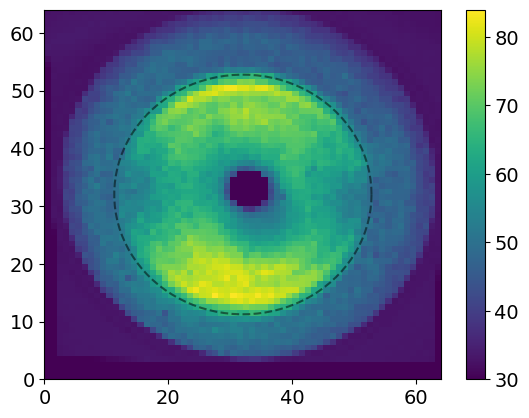

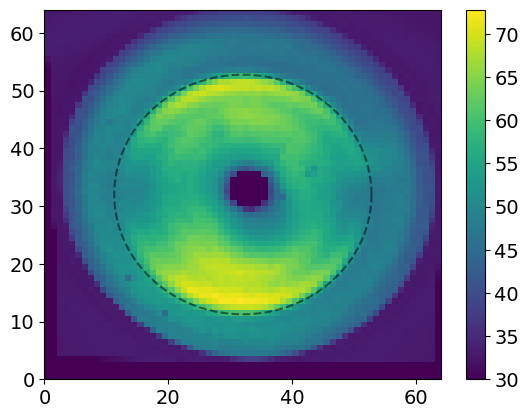

In [219]:
X,Y=np.meshgrid(np.arange(1024),np.arange(1024))
rs=np.sqrt((X-512)**2+(Y-512)**2)
maskcheck=np.zeros((1024,1024))
maskcheck[(rs<325)] = 1

bg = maskcheck*mean_unstreaked2
maskcheck=np.zeros((1024,1024))
maskcheck[(rs>=325)] = 1
bg += maskcheck*mean_unstreaked3

plt.pcolormesh(rebin(rebin(bg,4),4), vmin = 30)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'k--', alpha = 0.5)
plt.show()
plt.pcolormesh(rebin(rebin(mean_unstreaked,4),4), vmin = 30)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'k--', alpha = 0.5)


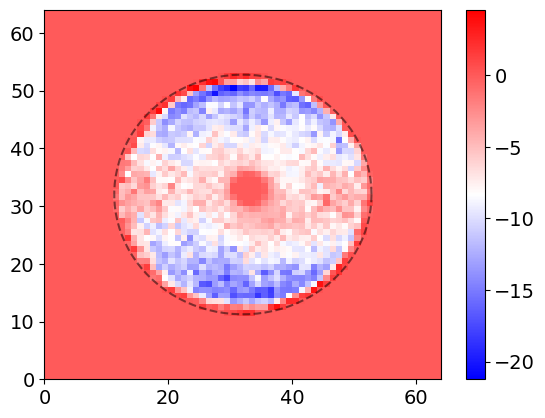

In [212]:
plt.pcolormesh(rebin(rebin((mean_unstreaked3-mean_unstreaked2)*maskcheck,4),4), cmap = 'bwr')# ,vmin = 40)
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'k--', alpha = 0.5)

plt.colorbar()

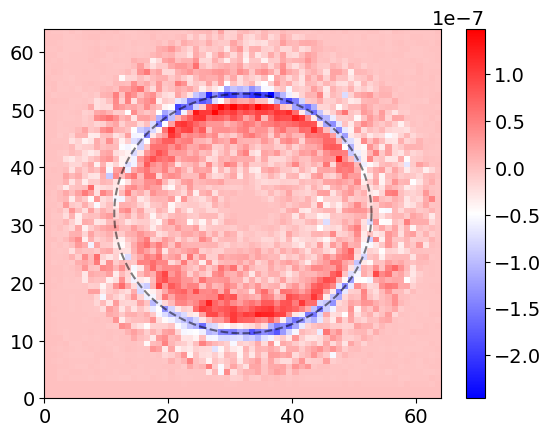

In [207]:
plt.pcolormesh(rebin(rebin(mean_unstreaked/np.sum(mean_unstreaked)- mean_unstreaked3/np.sum(mean_unstreaked3),4),4), cmap = 'bwr')# ,vmin = 30
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'k--', alpha = 0.5)

plt.colorbar()

In [54]:
for i in np.arange(100,len(mdat)):
    qqs = bgdat['quads'][np.argmax(bins-detsum[i]>0)-1]
    if np.sum(qqs) == 0: continue #need to fix this
    resid = bgdat['bg_im'][np.argmax(bins-detsum[i]>0)-1]
    quads = make_quads(qqs)
    ims2 = imsM[i]*quads
    ims2 = mf(ims2, mfn)
    ims2 = gf(ims2, gfn)
    ims2= rebin(rebin(ims2,4),4)
    m = np.max(ims2) #when making dipole bg
    resid_scale = resid/np.mean(resid*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))

    ims2 = ims2 - resid_scale
    #ims2 = gf(ims2,.25)

    ims2 = ims2*rebin(rebin(maskhm,4),4)*250/np.max(ims2)
    ims2[ims2<thresh] = 0

    msnew.append(ims2)
    print(len(msnew))

101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204


In [55]:
len(msnew)

204

In [52]:
len(mdat)

204

In [57]:
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/Ms_Jul29_112.npy',msnew)
np.save('/cds/home/p/paris/reconVMI_clean/recon X510 Dec/specs_Jul29_112.npy',specdat)


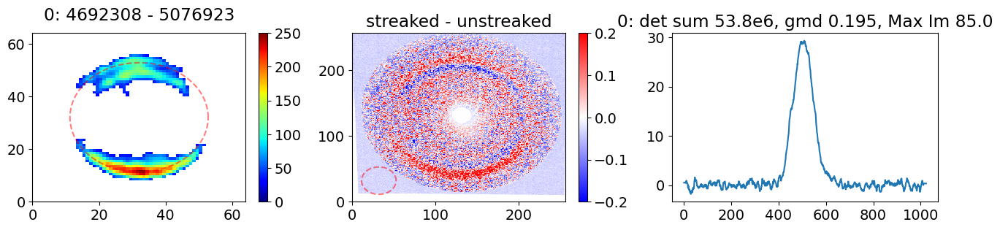

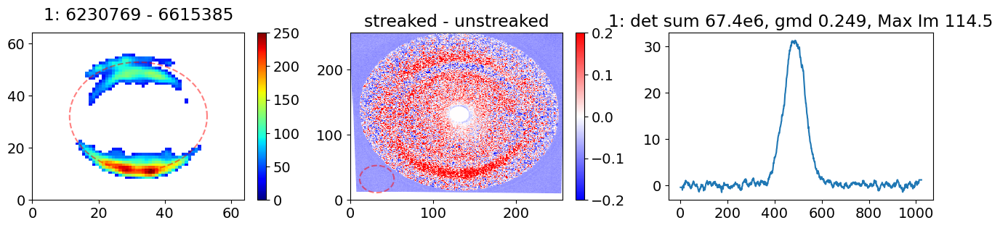

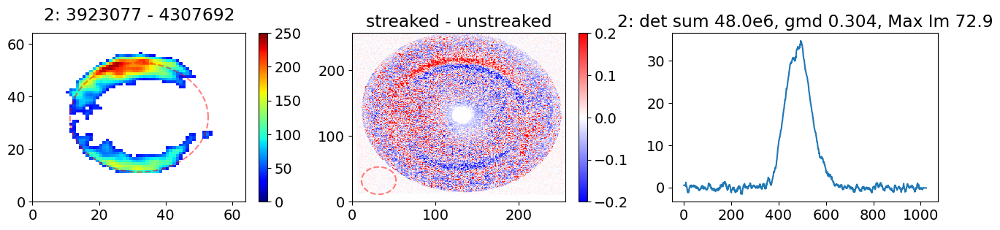

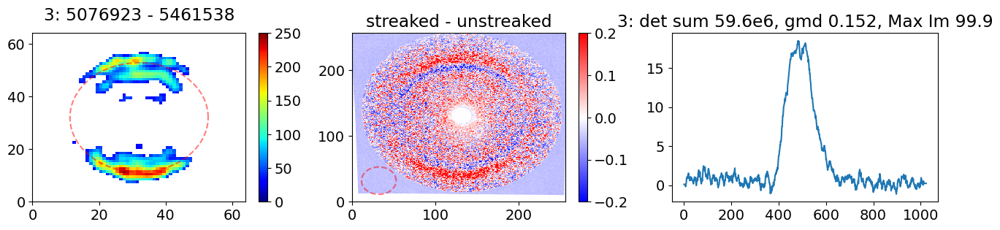

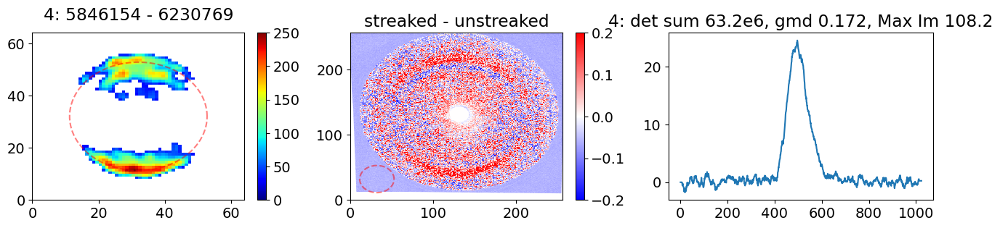

...

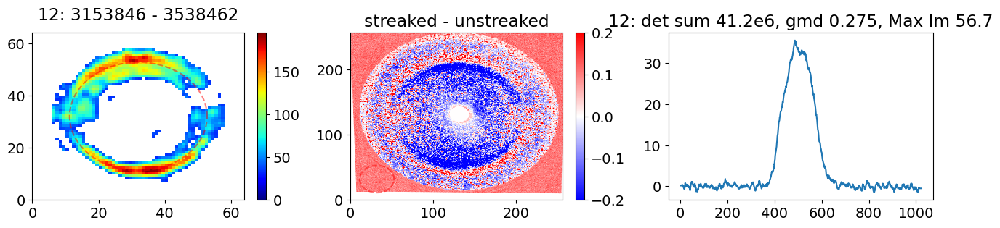

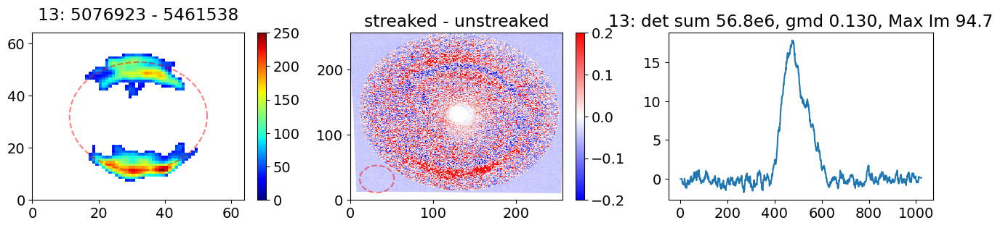

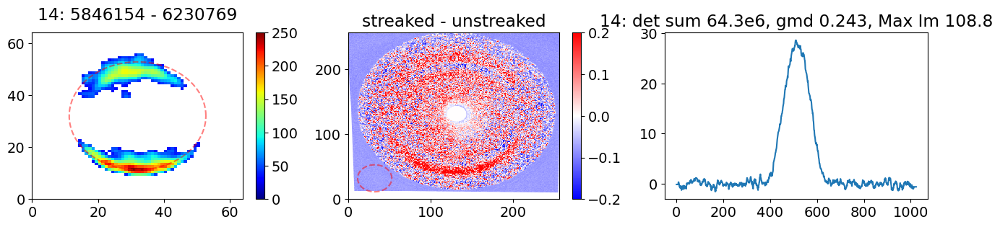

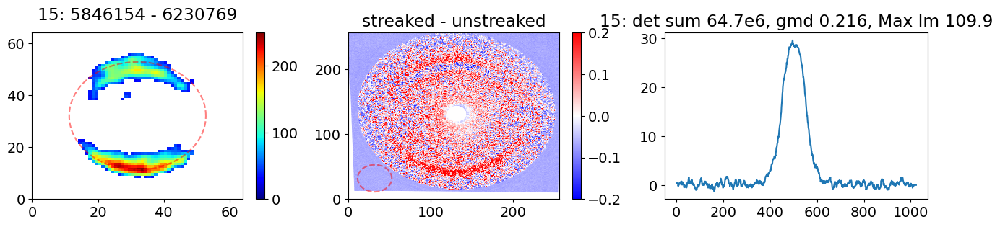

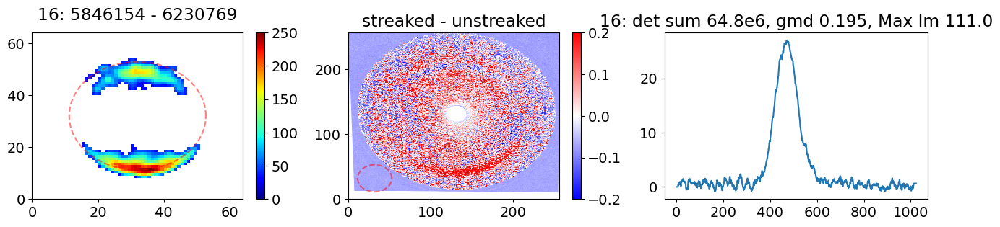

In [236]:
msnew = []
phi_rad = np.linspace(0,360,100)*np.pi/180
for i in range(len(ims_bg)):
    
    # idx = np.max((np.argmax(bins-binvar[i]>0)-1, 0))
    # idx = np.arange(idx-1,idx+1)
    idx = np.arange(1,12)
    try:
        len(idx)
        resid = np.mean(bg_im[idx],axis = 0)
        qqs = np.mean(bgdat['quads'][idx],axis = 0)
    except: 
        qqs = bgdat['quads'][idx]
        resid = bg_im[idx]
    
    if 0 in [np.sum(qqss) for qqss in bgdat['quads'][idx]]: continue #need to fix this
    
    quads = make_quads(qqs)
    ims2 = imsM[i]*quads
    ims2 = mf(ims2, mfn)
    ims2 = gf(ims2, gfn)
    ims2= rebin(rebin(ims2,4),4)
    #m = np.max(ims2) #when making dipole bg
    #maxim.append(m)
    resid_scale = resid/np.mean(resid*rebin(rebin(maskscale,4),4))*np.mean(ims2*rebin(rebin(maskscale,4),4))
    preim = np.copy(ims2)
    ims2 = ims2 - resid_scale
    #ims2 = gf(ims2, 0.2)
    ims2 = ims2*rebin(rebin(maskhm,4),4)*250/np.max(ims2)
    ims2[ims2<thresh] = 0
    msnew.append(ims2)
    
    
    fig,axs = plt.subplots(nrows = 1, ncols = 3, figsize = (16,3))
    p = axs[0].pcolormesh(ims2, cmap = my_cmap)
    plt.colorbar(p, ax = axs[0])
    axs[0].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    axs[2].plot(specs[i])
    plt.title('%1.0f: det sum %1.1fe6, gmd %1.3f, Max Im %1.1f' %(i, np.sum(detsum[i]/1e6), GDs_bg[i], maxim[i]))
    axs[0].set_title('%1.0f: %1.0f - %1.0f' %(i, bins[np.argmax(bins-binvar[i]>0)-1],bins[np.argmax(bins-binvar[i]>0)-1+1]), y = 1.04)
    #plt.colorbar()

    ims2 = imsM[i]*quads
    #ims2 = ims2*maskhm/np.sum(ims2*maskhm) - mean_unstreaked*quads*maskhm/np.sum(mean_unstreaked*quads*maskhm)
    ims2 = ims2/np.sum(ims2) - mean_unstreaked*quads/np.sum(mean_unstreaked*quads)
    #ims2 = ims2-np.mean(ims2) - (mean_unstreaked*quads-np.mean(mean_unstreaked*quads))
    exp = np.log10(np.max(ims2))
    p = axs[1].pcolormesh(rebin(ims2,4)/(10**exp), cmap = 'bwr', vmin = - 0.2, vmax = 0.2)
    
    
    plt.colorbar(p, ax = axs[1])
    axs[1].plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
    axs[1].set_title('streaked - unstreaked')
    plt.show()
    

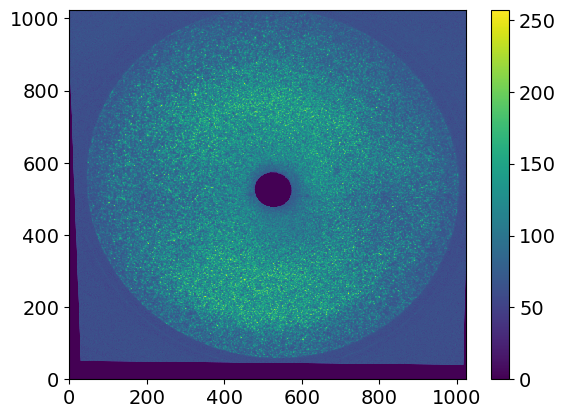

In [25]:
plt.pcolormesh(imsM[0]*quads +imsM[11]*quads - np.abs(imsM[0]*quads -imsM[11]*quads))
plt.colorbar()

In [26]:
z = imsM[0]*quads +imsM[11]*quads - np.abs(imsM[0]*quads -imsM[11]*quads)

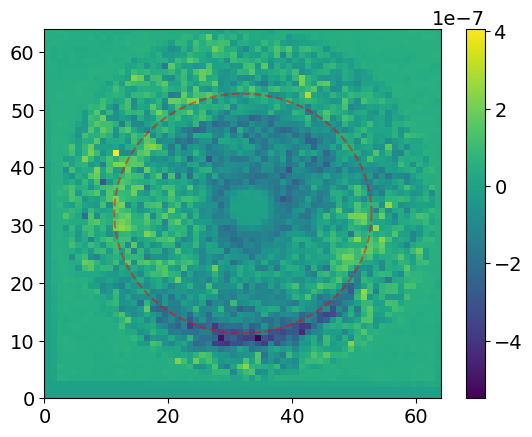

In [37]:
j = 2
plt.pcolormesh(rebin(rebin(imsM[j]*quads/np.sum(imsM[j]*quads)-z/np.sum(z),4),4))
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)

In [13]:
phi_rad = np.linspace(0,360,100)*np.pi/180

In [29]:
M1 = imsM[0]*quads
M2 = imsM[4]*quads
x = M1 + M2 - np.abs(M1-M2)
bg  = x/(np.sum(M1) + np.sum(M2))

In [31]:
np.max(M1),np.max(M2)

(215.65828125, 75.206162109375)

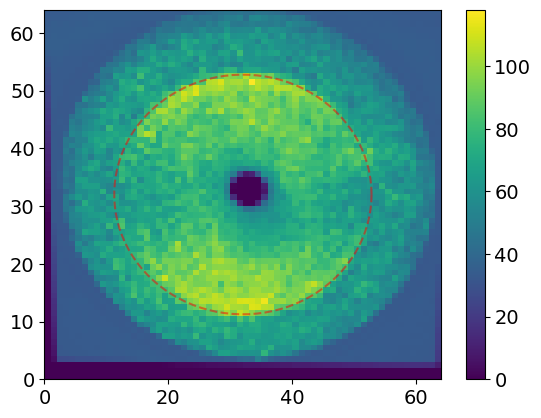

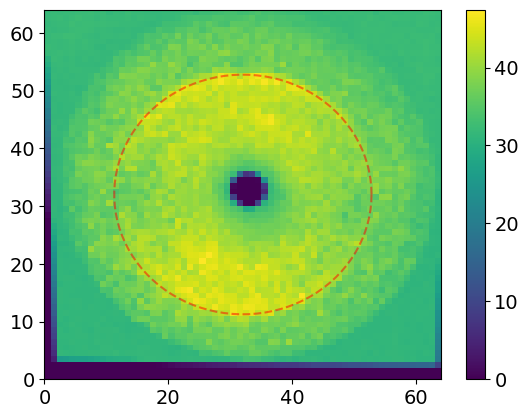

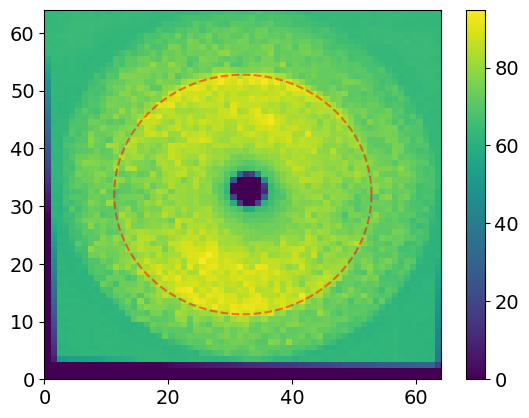

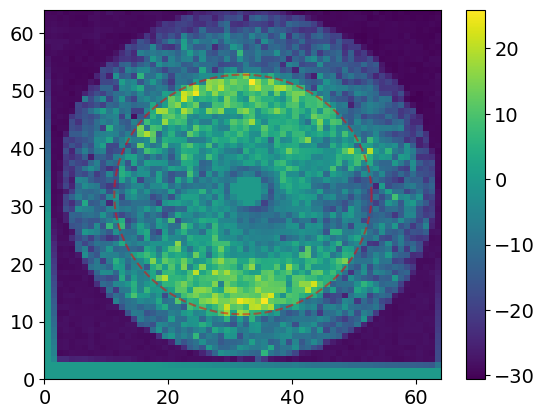

In [18]:
plt.pcolormesh(rebin(rebin(M1,4),4))
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()

plt.pcolormesh(rebin(rebin(M2,4),4))
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()

plt.pcolormesh(rebin(rebin(x,4),4))
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()

plt.pcolormesh(rebin(rebin(M1 - x,4),4))
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)

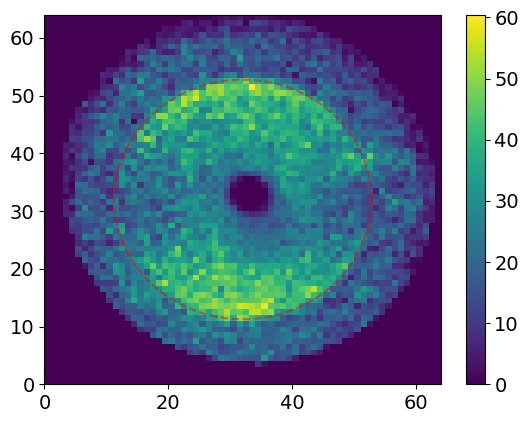

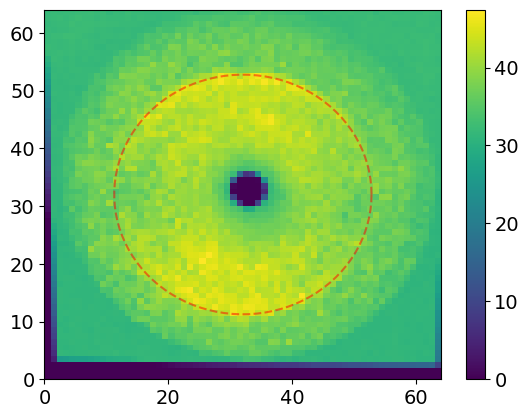

In [43]:
plt.pcolormesh(rebin(rebin(M1 - bg*np.sum(M1),4),4), vmin = 0)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()

plt.pcolormesh(rebin(rebin(M2-x/np.sum(M2),4),4), vmin = 0)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)

In [256]:
imMask = [i*maskhm for i in imsM]
for i in range(len(imMask)):
    temp = imMask[i]
    temp[temp <30] = np.nan
    imMask[i] = temp

In [263]:
immm = [i - np.mean(i) for i in imsM]
immmMask = [i - np.nanmean(i) for i in imMask]

(array([6.66020e+04, 1.48701e+05, 1.41386e+05, 9.13030e+04, 4.25690e+04,
        1.42920e+04, 3.39300e+03, 5.61000e+02, 6.30000e+01, 6.00000e+00]),
 array([ 32.15625  ,  51.1734375,  70.190625 ,  89.2078125, 108.225    ,
        127.2421875, 146.259375 , 165.2765625, 184.29375  , 203.3109375,
        222.328125 ]),
 <BarContainer object of 10 artists>)

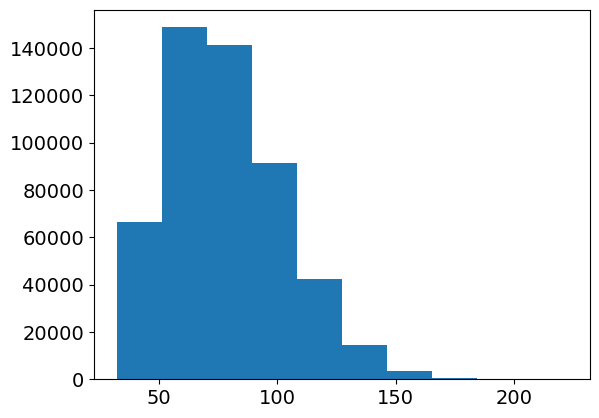

In [260]:
plt.hist(imMask[0].flatten())

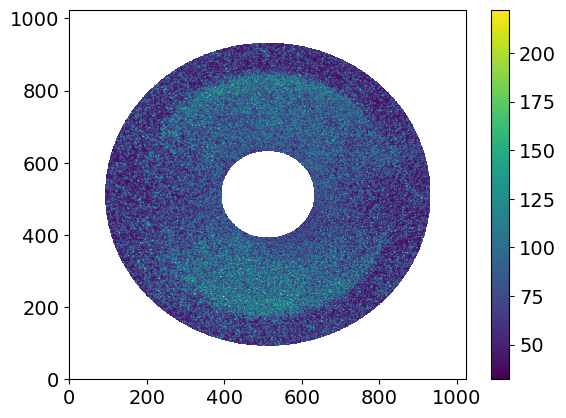

In [261]:
plt.pcolormesh(imMask[0])
plt.colorbar()

In [264]:
# Mmean = np.mean(imsM[:30],axis = 0)
# Mmedian = np.median(imsM[:30],axis = 0)
Mmean = np.mean(immm[:30],axis = 0)
Mmedian = np.median(immm[:30],axis = 0)
Mmeanmask = np.mean(immmMask[:30],axis = 0)

/reg/d/psdm/tmo/tmox51020/results/paris/recon/recon_funcs.py:62: RuntimeWarning: Mean of empty slice
  return np.nanmean(np.nanmean(arr.reshape(shape), axis=-1), axis=1)


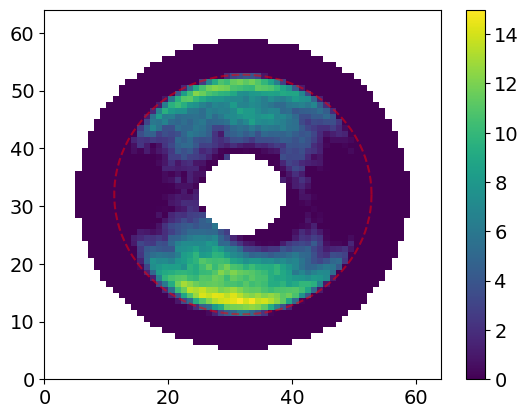

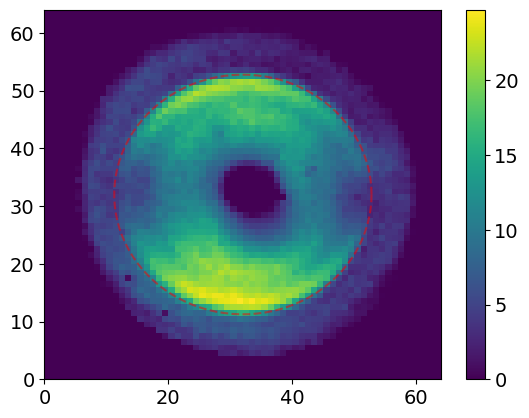

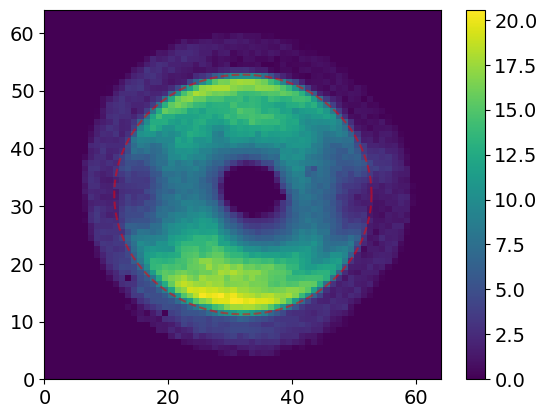

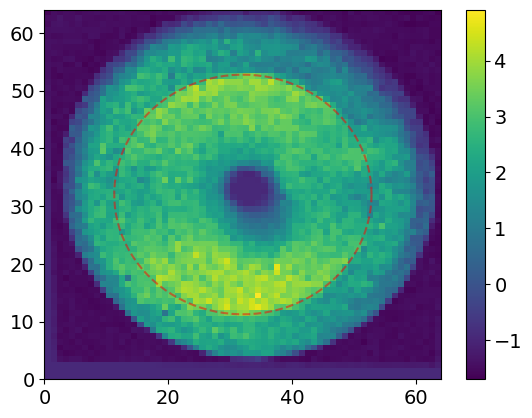

In [265]:
plt.pcolormesh(rebin(rebin(Mmeanmask,4),4), vmin = 0)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()

plt.pcolormesh(rebin(rebin(Mmean,4),4), vmin = 0)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()


plt.pcolormesh(rebin(rebin(Mmedian,4),4), vmin = 0)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()

plt.pcolormesh(rebin(rebin(Mmean -Mmedian,4),4))
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()

In [91]:
Mmean[Mmean < 0] = 0
Mmedian[Mmedian < 0] = 0
Bgmean = np.mean(imsM,axis = 0) - Mmean
Bgmedian = np.mean(imsM,axis = 0) - Mmedian

In [122]:
Bgmean = Bgmean - np.mean(Bgmean)
Bgmedian = Bgmedian - np.mean(Bgmedian)

In [130]:
Bgmean[Bgmean < 0] = 0
Bgmedian[Bgmedian < 0] = 0

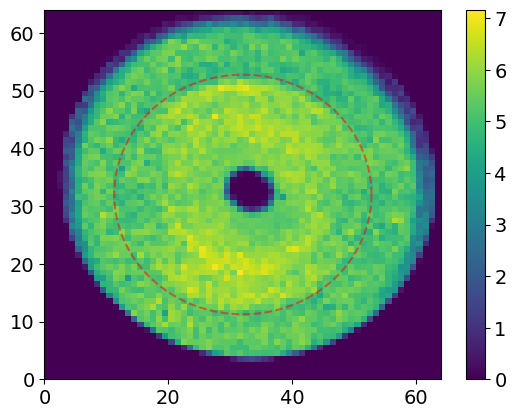

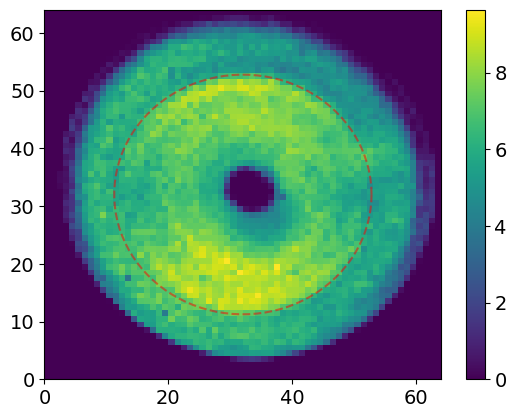

In [131]:
plt.pcolormesh(rebin(rebin(Bgmean,4),4))
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()

plt.pcolormesh(rebin(rebin(Bgmedian,4),4))
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()


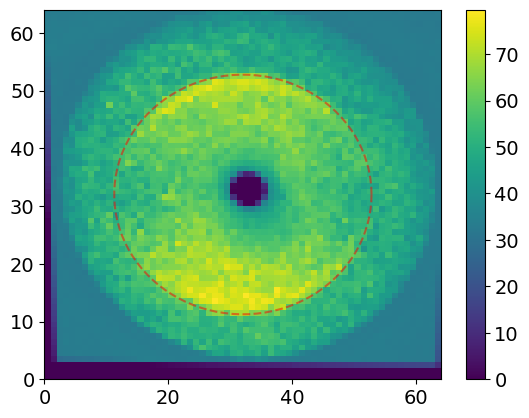

In [136]:
plt.pcolormesh(rebin(rebin(Mplot,4),4), vmin = 0)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()


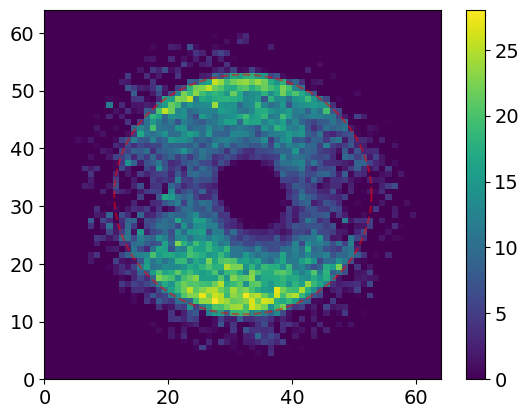

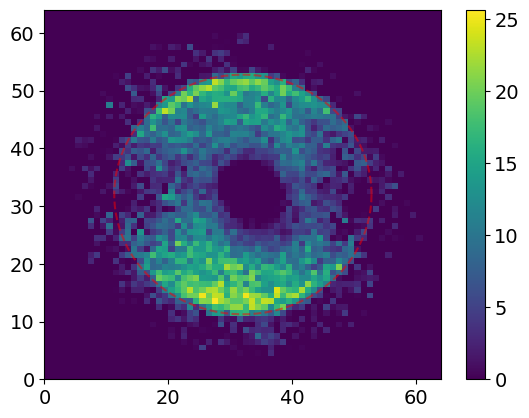

In [134]:
Mplot = imsM[2]
plt.pcolormesh(rebin(rebin(Mplot - (Bgmean+np.mean(Mplot)),4),4), vmin = 0)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()

plt.pcolormesh(rebin(rebin(Mplot- (Bgmedian+np.mean(Mplot)),4),4), vmin = 0)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
# plt.pcolormesh(rebin(rebin(Mplot - Mmean/np.sum(Mmean)*np.sum(Mplot),4),4))
# plt.colorbar()
# plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
# plt.show()

# plt.pcolormesh(rebin(rebin(Mplot - Mmedian/np.sum(Mmedian)*np.sum(Mplot),4),4))
# plt.colorbar()
# plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)

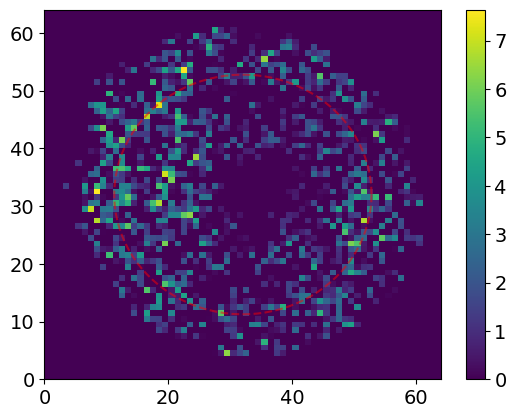

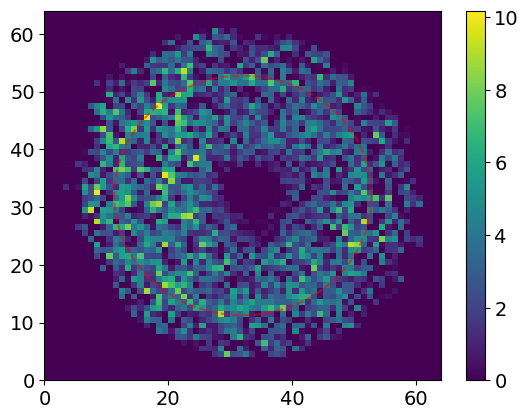

In [87]:
Mplot = imsM[5]
plt.pcolormesh(rebin(rebin(Mplot - (Mmean+np.mean(Mplot)),4),4), vmin = 0)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.show()

plt.pcolormesh(rebin(rebin(Mplot - (Mmedian+np.mean(Mplot)),4),4), vmin = 0)
plt.colorbar()
plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
# plt.pcolormesh(rebin(rebin(Mplot - Mmean/np.sum(Mmean)*np.sum(Mplot),4),4))
# plt.colorbar()
# plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
# plt.show()

# plt.pcolormesh(rebin(rebin(Mplot - Mmedian/np.sum(Mmedian)*np.sum(Mplot),4),4))
# plt.colorbar()
# plt.plot((512+332*np.cos(phi_rad))/16, (512+332*np.sin(phi_rad))/16, 'r--', alpha = 0.5)

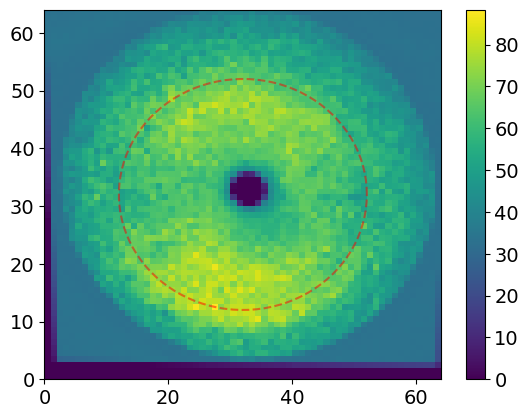

In [215]:
look = streaked[0] #imsM[2]
plt.pcolormesh(rebin(rebin(look,4),4))
plt.colorbar()
plt.plot((512+320*np.cos(phi_rad))/16, (512+320*np.sin(phi_rad))/16, 'r--', alpha = 0.5)

In [200]:
#imsMsm = [gf(mf(imsM[i],mfn),gfn) for i in range(len(imsM))]

In [216]:
imsM_cent = [((imsMsm[i]-np.mean(imsMsm[i]))*maskhm) for i in range(len(imsM))]
imsM_cent_sc = [((imsMsm[i]-np.mean(imsMsm[i]))*maskhm)/np.std((imsMsm[i]-np.mean(imsMsm[i]))*maskhm) for i in range(len(imsM))]

In [217]:
look = gf(mf(look,mfn),gfn) 
stack_subtracted = [((look-np.mean(look))*maskhm) - imsM_cent[i] for i in range(len(imsM_cent))]
stack_subtracted = np.array(stack_subtracted)
stack_subtracted_sc = [((look-np.mean(look))*maskhm)/np.std(((look-np.mean(look))*maskhm)) - imsM_cent_sc[i] for i in range(len(imsM_cent))]
stack_subtracted_sc = np.array(stack_subtracted_sc)

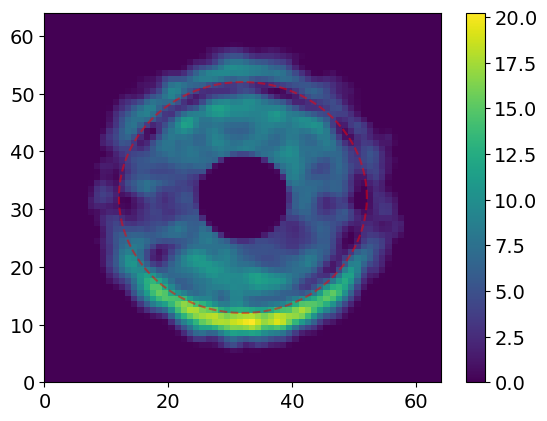

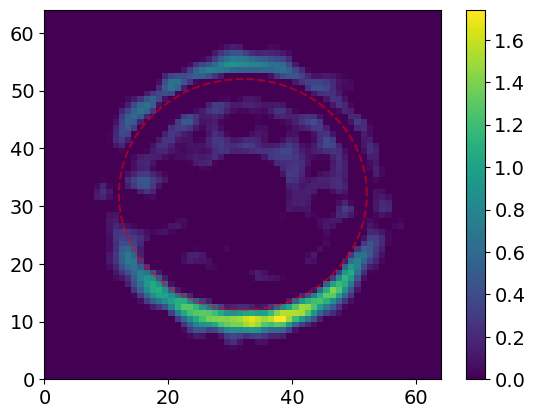

In [218]:
plt.pcolormesh(rebin(rebin(np.median(stack_subtracted,axis = 0),4),4), vmin = 0)
plt.plot((512+320*np.cos(phi_rad))/16, (512+320*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()
plt.show()

plt.pcolormesh(rebin(rebin(np.median(stack_subtracted_sc,axis = 0),4),4), vmin = 0)
plt.plot((512+320*np.cos(phi_rad))/16, (512+320*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()

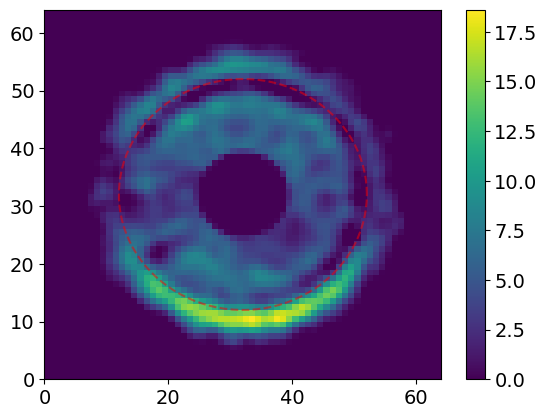

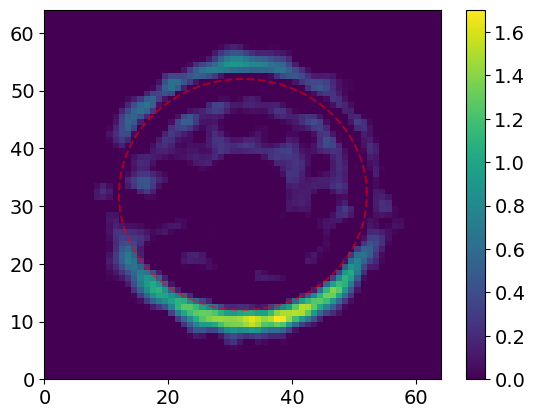

In [219]:
plt.pcolormesh(rebin(rebin(np.mean(stack_subtracted,axis = 0),4),4), vmin = 0)
plt.plot((512+320*np.cos(phi_rad))/16, (512+320*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()
plt.show()

plt.pcolormesh(rebin(rebin(np.mean(stack_subtracted_sc,axis = 0),4),4), vmin = 0)
plt.plot((512+320*np.cos(phi_rad))/16, (512+320*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()

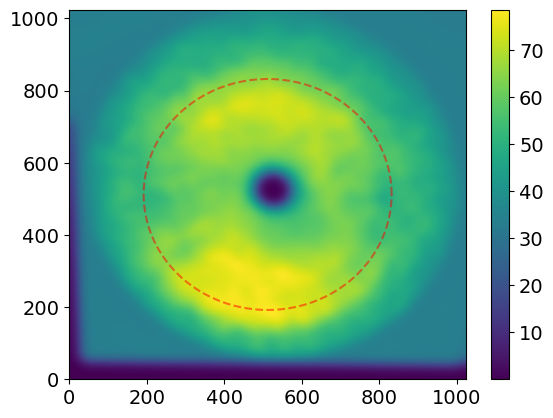

In [268]:
plt.pcolormesh(look)
plt.plot((512+320*np.cos(phi_rad)), (512+320*np.sin(phi_rad)), 'r--', alpha = 0.5)
plt.colorbar()

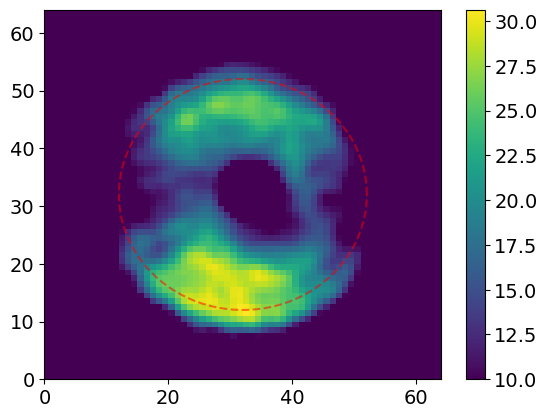

In [272]:
plt.pcolormesh(rebin(rebin(look-np.mean(look),4),4), vmin = 10)
plt.plot((512+320*np.cos(phi_rad))/16, (512+320*np.sin(phi_rad))/16, 'r--', alpha = 0.5)
plt.colorbar()

In [198]:
streaked = []

ds=ps.DataSource(exp = 'tmox51020', run= runnum, timestamps=tt)
#ds=ps.DataSource(exp = 'tmox51020', run= runnum, filter = lambda evt:evt.timestamp in tt)

run = next(ds.runs())

opal1 = run.Detector('tmo_opal1') # OPAL camera looking at the holey mirror
gmd = run.Detector("gmd") # gas intensity detector 
timing = run.Detector('timing') # this gives access to evr codes
ebeam = run.Detector("ebeam")
opalfzp = run.Detector('tmo_fzpopal') 



if hasattr(run, 'epicsinfo'):
    epics_strs = [item[0] for item in run.epicsinfo.keys()][1:] # first one is weird
    epics_detectors = [run.Detector(item) for item in epics_strs]    

for nevent, event in enumerate(run.events()):

    # data = {'epics_'+epic_str: epic_det(event) for epic_str, epic_det in zip(epics_strs, epics_detectors)}        
    # if any(type(val) not in [int, float] for val in data.values()):
    #     print("Bad EPICS: %d" % nevent)
    #     #Nbad += 1
    #     continue

    # fetch the information from the different events
    im_look=np.copy(opal1.raw.raw(event))  #opal1im_i=np.copy(opal1.raw.image(event)) #doesn't work since update
    im1=im_look

    ims = np.rot90(im1*mask)
    #ims = cv2.warpPerspective(ims,MM,(1024,1024))
    gasoff = 0 #gasoff0#/np.mean(gasoff0)*np.mean(ims)
    ims = cv2.warpPerspective(ims-gasoff,MM,(1024,1024))
    streaked.append(ims)

    print(event.timestamp) 
    

4410466594902752439
4410466860991124424
4410467066956109577
4410467118880680054
4410467157315318992
4410467183348972960
4410467239018794927
4410467363985340688
4410467509338302448
4410467513749662082
4410467518544276382
4410467530828476158
4410467613009185416
4410467668872994012
4410467689813058340
4410467694240933052
4410467754356193385
